In [1]:
# Some configuration variables
study_dir = "/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean"
PSUstudy_dir = "/data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean"
dataDir = "/data/perlman/moochie/study_data/P-CAT/task_data"
PSUdataDir = "/data/perlman/moochie/study_data/P-CAT/PSU_data/task_data"
task = "Flanker"
participant_num_len = 4 # default length of participant numbers
ex_subs = [] # any subjects to not include in the dataset

In [7]:
# from data tracker July 12th 2022, list of subjects with v3 Flanker completed
in_subs = [

#     "1102", 
#     "1103",
#     "1104",
#     "1109",
#     "1110",
#     "1112",
#     "1113",
#     "1114" these all were old Flanker versions
    # had different experiment version
    "1115",
    "1116",
#     "1110", didn't do flanker, less 80% practice
    "1114",
#     "1119", # refused to flank
    "1121",
    "1122",
    "1126",
    "1125",
    "1127",
#     "1128", sibling participated
    "1129",
    "1134",
    "1130",
#     "1131", <20% on practice
#     "1137", lower extreme on KBIT
#     "1124", # took off cap midway through, they did the first couple blocks
    "1133",
#     "1138", <20% on practice 
    "1144",
    "1143",
#     "1141", <20% on practice
    "1145",
    "1149",
    "1154",
    "1155",
#     "1142", <20% on practice
    "1148",
    "1156",
    # june 24 updates
    "1159",
    # "1160", failed practice
    ### Sep 21st updates
    "1162",
#     "1164", no flank
#     "1165", no flank
    "1167",
#     "1168", no flank
    "1170",
    "1139",
    "1146",
]

# PSU stuff
PSU_insubs = [
    "1202",
#     "1203", # issue... no flanker data collected
    "1204",
#     "1205", # failed practice
    "1207",
    "1209",
    "1211",
    "1213",
#     "1214", # failed practice
#     "1216", # failed practice
    "1219",
    "1220",
#     "1221", # failed practice
#     "1222", # failed practice
    "1223",
#     "1234", # failed practice
#     "1229", # failed practice 
#     "1231", # failed practice
    "1238",
    "1226",
    ### Sep 21st updates
    "1227",
    "1228",
    "1235",
    "1236",
    "1239",
    "1242",
    # others
    "1243",
    "1244",
    "1246",
    "1247",
    "1251",
    "1253",
    "1254"
]

for sub in PSU_insubs:
    in_subs.append(sub)

In [8]:
len(in_subs)

50

In [9]:
len(in_subs) - len(PSU_insubs)

26

In [10]:
# copy/paste of all subjects from data tracker, and the age column as well, so that they're all order-matched

# upd. sep 21, 2022
all_subs = [
    "1102",
    "1109",
    "1103",
    "1104",
    "1112",
    "1115",
    "1116",
    "1110",
    "1117",
    "1118",
    "1114",
    "1119",
    "1121",
    "1122",
    "1126",
    "1113",
    "1125",
    "1127",
    "1128",
    "1129",
    "1134",
    "1130",
    "1131",
    "1137",
    "1124",
    "1133",
    "1138",
    "1144",
    "1143",
    "1151",
    "1145",
    "1141",
    "1147",
    "1149",
    "1154",
    "1155",
    "1152",
    "1139",
    "1142",
    "1148",
    "1156",
    "1159",
    "1160",
    "1164",
    "1165",
    "1162",
    "1166",
    "1146",
    "1167",
    "1168",
    "1170"]

# PSU stuff
PSU_subs = [
    "1200",
    "1201",
    "1202",
    "1203",
    "1204",
    "1205",
    "1206",
    "1207",
    "1208",
    "1209",
    "1210",
    "1211",
    "1212",
    "1213",
    "1214",
    "1216",
    "1218",
    "1219",
    "1220",
    "1221",
    "1222",
    "1223",
    "1225",
    "1226",
    "1227",
    "1228",
    "1229",
    "1231",
    "1232",
    "1234",
    "1235",
    "1236",
    "1237",
    "1238",
    "1239",
    "1240",
    "1241",
    "1242",
    "1243",
    "1244",
    "1245",
    "1246",
    "1247",
    "1248",
    "1249",
    "1250",
    "1251",
    "1252",
    "1253",
    "1254"]

for sub in PSU_subs:
    all_subs.append(sub)

In [11]:
len(PSU_subs)

50

In [12]:
len(all_subs) - len(PSU_subs)

51

In [13]:
# upd. sep 21, 2022
ages = [
    6.42026009582478,
    5.1006160164271,
    6.38193018480493,
    4.68993839835729,
    7.97809719370294,
    6.55989048596851,
    7.43326488706366,
    4.8952772073922,
    6.78439425051335,
    5.09787816563997,
    4.58316221765914,
    4.51471594798084,
    7.87953456536619,
    5.37987679671458,
    7.97535934291581,
    4.03285420944559,
    7.71252566735113,
    7.81656399726215,
    0.0,
    7.45516769336071,
    5.86173853524983,
    6.6009582477755,
    4.3750855578371,
    4.07939767282683,
    6.13826146475017,
    4.35318275154004,
    5.13894592744695,
    5.7056810403833,
    7.42778918548939,
    4.51745379876797,
    6.40930869267625,
    4.03011635865845,
    6.01779603011636,
    7.67693360711841,
    6.94318959616701,
    4.35592060232717,
    0.0,
    7.76180698151951,
    4.03832991101985,
    5.93018480492813,
    5.36344969199179,
    4.254620123,
    5.12251882272416,
    4.70636550308008,
    5.48117727583847,
    5.9192334017796,
    0.0,
    7.58110882956879,
    5.08418891170431,
    4.17248459958932,
    6.58179329226557]

# PSU stuff
PSU_ages = [
    5.88364134154689,
    0.0,
    5.71663244353183,
    5.84804928131417,
    5.91375770020534,
    6.37645448323066,
    0.0,
    6.08624229979466,
    0.0,
    5.30047912388775,
    0.0,
    4.18617385352498,
    0.0,
    4.85694729637235,
    4.42710472279261,
    4.49828884325804,
    0.0,
    6.92676249144422,
    6.34086242299795,
    4.99657768651609,
    4.50376454483231,
    5.68377823408624,
    7.75085557837098,
    7.84941820670773,
    4.24366872005476,
    5.1006160164271,
    4.20807665982204,
    4.99383983572895,
    0.0,
    4.34496919917865,
    7.34839151266256,
    7.7700205338809,
    7.0444900752909,
    6.48596851471595,
    6.20670773442847,
    0.0,
    0.0,
    4.48733744010951,
    5.85626283367557,
    7.35386721423682,
    5.63997262149213,
    5.71937029431896,
    5.94661190965092,
    5.25119780971937,
    5.57426420260096,
    0.0,
    6.080766598, #1251, problematic little bugger
    0.0,
    5.9356605065024,
    6.51334702258727]

for age in PSU_ages:
    ages.append(age)

In [14]:
len(PSU_ages)

50

In [15]:
len(ages) - len(PSU_ages)

51

In [16]:
# General dependencies
import os, shutil
from os.path import join
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from copy import deepcopy
from glob import glob
import math

# nirs-specific dependencies
from itertools import compress
import mne
import mne_nirs
# mne.viz.set_3d_backend("notebook")

In [17]:
mne.__version__

'0.24.0'

In [18]:
# plt.rcParams["figure.figsize"] = (10, 6)

In [19]:
# LCBD dependencies
# add relative path to our toolbox
import sys
sys.path.append('../../../..')
from LCBDtools.scripts import argParser
from LCBDtools.src import Plots

In [20]:
# use a glob to get all the Flanker directories in the study dir

# for WUSTL
session_dirs = [d for d in glob(study_dir+"/*/*Flanker") if \
    os.path.basename(d)[:participant_num_len] in in_subs]

# for PSU
PSUsession_dirs = [d for d in glob(PSUstudy_dir+"/*/*Flanker") if \
    os.path.basename(d)[:participant_num_len] in in_subs]

# make a list of all the subjects from these directories
subjects = list(set([os.path.basename(d)[:participant_num_len] for d in session_dirs]))

In [21]:
session_dirs

['/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1148/1148_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1170/1170_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1126/1126_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1114/1114_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1156/1156_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1121/1121_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1145/1145_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1125/1125_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1167/1167_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1122/1122_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1155/1155_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1146/1146_Flanker',
 '/data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1139/1139_Flanker',
 '/data/perlman/moochie/a

In [22]:
# mne.viz.set_3d_backend('pyvista')

# make the list where all the MNE.io.raw objects will go
raw_intensities = []

# loop over all the WUSTL session folders
for ses in session_dirs:

    # try to load it in as MNE object
    try:
        raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
    except:
        print("Failure to load:", ses, "skipping.")

# same for PSU data
for ses in PSUsession_dirs:
    
    try:
        raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
    except:
        print("Failure to load:", ses, "skipping.")

Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1148/1148_Flanker
Reading 0 ... 6187  =      0.000 ...   791.936 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1170/1170_Flanker
Reading 0 ... 6069  =      0.000 ...   776.832 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1126/1126_Flanker
Reading 0 ... 6552  =      0.000 ...   838.656 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1114/1114_Flanker
Reading 0 ... 6163  =      0.000 ...   788.864 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1156/1156_Flanker
Reading 0 ... 6439  =      0.000 ...   824.192 secs...


<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())


Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1121/1121_Flanker
Reading 0 ... 6028  =      0.000 ...   771.584 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1145/1145_Flanker
Reading 0 ... 6137  =      0.000 ...   785.536 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1125/1125_Flanker
Reading 0 ... 6068  =      0.000 ...   776.704 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1167/1167_Flanker
Reading 0 ... 6136  =      0.000 ...   785.408 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1122/1122_Flanker
Reading 0 ... 6156  =      0.000 ...   787.968 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1155/1155_Flanker
Reading 0 ... 6347  =      0.000 ...   812.416 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1146/1146_Flanker
Reading 0 ... 5984  =      0.000 ...   765.952 secs...


<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since

Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1139/1139_Flanker
Reading 0 ... 6329  =      0.000 ...   810.112 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1133/1133_Flanker
Reading 0 ... 6307  =      0.000 ...   807.296 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1144/1144_Flanker
Reading 0 ... 6230  =      0.000 ...   797.440 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1127/1127_Flanker
Reading 0 ... 6240  =      0.000 ...   798.720 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1115/1115_Flanker
Reading 0 ... 6200  =      0.000 ...   793.600 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1162/1162_Flanker
Reading 0 ... 6136  =      0.000 ...   785.408 secs...


<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())


Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1149/1149_Flanker
Reading 0 ... 6260  =      0.000 ...   801.280 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1143/1143_Flanker
Reading 0 ... 6100  =      0.000 ...   780.800 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1134/1134_Flanker
Reading 0 ... 6528  =      0.000 ...   835.584 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1130/1130_Flanker
Reading 0 ... 6521  =      0.000 ...   834.688 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1129/1129_Flanker
Reading 0 ... 6172  =      0.000 ...   790.016 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1154/1154_Flanker
Reading 0 ... 6219  =      0.000 ...   796.032 secs...


<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())
<ipython-input-22-16eda4760bbb>:7: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())


Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1159/1159_Flanker
Reading 0 ... 6351  =      0.000 ...   812.928 secs...
Loading /data/perlman/moochie/analysis/P-CAT/NIRS_data_clean/1116/1116_Flanker
Reading 0 ... 6218  =      0.000 ...   795.904 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1209/1209_Flanker
Reading 0 ... 6256  =      0.000 ...   800.768 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1246/1246_Flanker
Reading 0 ... 6163  =      0.000 ...   788.864 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1236/1236_Flanker
Reading 0 ... 6142  =      0.000 ...   786.176 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1204/1204_Flanker
Reading 0 ... 6127  =      0.000 ...   784.256 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1219/1219_Flanker
Reading 0 ... 6066  =      0.000 ...   776.448 secs...
Loading /data/perlman/moochie/analysis/P-C

<ipython-input-22-16eda4760bbb>:15: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  raw_intensities.append(mne.io.read_raw_nirx(ses).load_data())


Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1239/1239_Flanker
Reading 0 ... 6199  =      0.000 ...   793.472 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1244/1244_Flanker
Reading 0 ... 6151  =      0.000 ...   787.328 secs...
Loading /data/perlman/moochie/analysis/P-CAT/PSU_NIRS_data_clean/1220/1220_Flanker
Reading 0 ... 6171  =      0.000 ...   789.888 secs...


In [23]:
print("We have loaded", len(raw_intensities), "instances of raw fNIRS data")

We have loaded 47 instances of raw fNIRS data


In [24]:
# for raw_ints in raw_intensities:
#     print(raw_ints.info['subject_info']['his_id'][:participant_num_len])

In [25]:
# raw_intensities[0].info['ch_names']

In [26]:
# function that plots all the source / detector pair connections as a networkx graph

def plot_sd_network():
    import networkx as nx
    from networkx.algorithms import bipartite
    
    G = nx.Graph()
    for ch_pair in list(set(raw_intensities[0].info['ch_names'])):
        source = ch_pair.split(' ')[0].split('_')[0]
        detector = ch_pair.split(' ')[0].split('_')[1]
        e = (source, detector)
        
        if e not in G.edges():
        
            if source not in G.nodes():
                G.add_node(source, bipartite=0)
            if detector not in G.nodes():
                G.add_node(detector, bipartite=1)
            
            G.add_edge(source, detector)

    top = {n for n, d in G.nodes(data=True) if d["bipartite"] == 0}
    pos = nx.bipartite_layout(G, top, align='horizontal')
    nx.draw(G, with_labels=True, pos=pos)
    
# plot_sd_network()

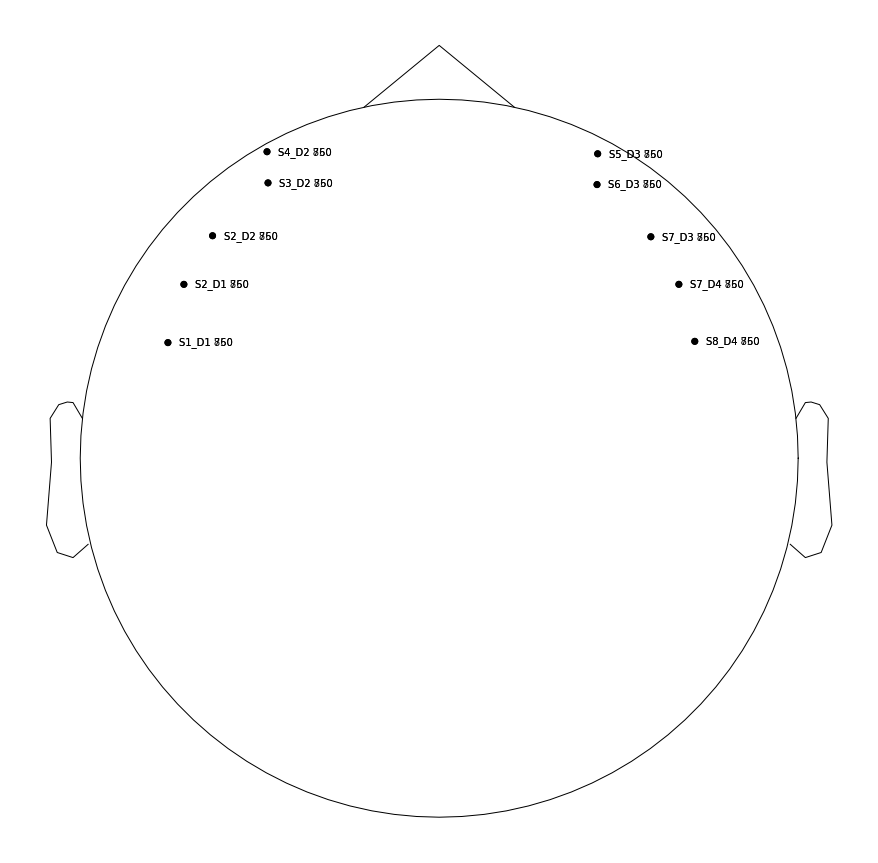

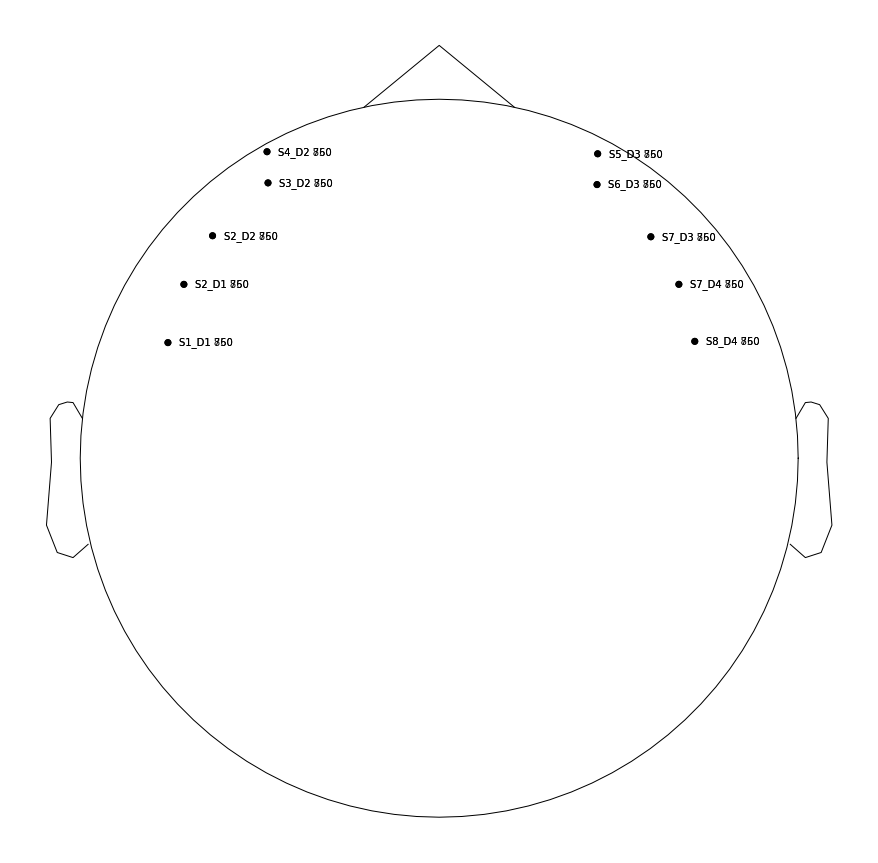

In [27]:
raw_intensities[0].plot_sensors(to_sphere=True, show_names=True, sphere=(0, 0.03, 0, 0.08)) # viz is screwed up lol

# Clean up annotations before analysis

Next we update the annotations by assigning names to each trigger ID. Then we crop the recording to the section containing our experimental conditions.

In [28]:
from mne_nirs.experimental_design import make_first_level_design_matrix
from mne_nirs.statistics import run_glm
from mne_nirs.channels import (
    get_long_channels,
    get_short_channels,
    picks_pair_to_idx)

from nilearn.plotting import plot_design_matrix

In [29]:
from LCBDtools.Stimuli.Flanker import TaskReader

In [30]:
# use a glob to get all the Flanker psychopy files
# for WUSTL
task_fnames = [fname for fname in glob(join(dataDir, '*', '*_'+task, '*.csv')) if \
    os.path.basename(fname)[:participant_num_len] in in_subs]

# for PSU
PSUtask_fnames = [fname for fname in glob(join(PSUdataDir, '*', '*_'+task, '*.csv')) if \
    os.path.basename(fname)[:participant_num_len] in in_subs]

# for fname in PSUtask_fnames:
#     task_fnames.append(fname)

In [31]:
# make a dictionary where all the Flanker behavioral data will be loaded in
# the keys will be subject numbers, and each item, accessible like d_dataset[subjectnum] will be a list
# of ~150 "Flanks", i.e. a "flankerSeries"
# each flank, accessible like d_dataset[subjectnum][flanknum] has a .meta attribute dictionary
# running, e.g. d_dataset[50301][20].meta will show the details for the 21st flank of subject 50301
# individual characteristics of that stimulus are accessible as a dictionary, e.g.
# d_dataset[50301][20].meta['congruent'] returns a True or False value 

d_dataset = {}

# add all the WUSTL data
for fname in task_fnames:
    try:
        flanker_series = TaskReader(fname).flankerSeries
        subject = os.path.basename(fname)[:participant_num_len]

        for flank in flanker_series:
            flank.eval()
            # also add their age to the meta data
            flank.meta['age'] = ages[all_subs.index(subject)]

        d_dataset[subject] = flanker_series
        
    except:
        print("Error encountered @ subject:", os.path.basename(fname)[:participant_num_len])  

In [32]:
# add all the PSU data
for fname in PSUtask_fnames:
    try:
        flanker_series = TaskReader(fname).flankerSeries
        subject = os.path.basename(fname)[:participant_num_len]

        for flank in flanker_series:
            flank.eval()
            # also add their age to the meta data
            flank.meta['age'] = ages[all_subs.index(subject)]

        d_dataset[subject] = flanker_series

    except:
        print("Error encountered @ subject:", os.path.basename(fname)[:participant_num_len]) 

In [33]:
len(d_dataset['1133'])

150

In [34]:
# the sample rate is accessible in the MNE.io.raw.info dictionary
sample_rate = raw_intensities[0].info['sfreq']

In [35]:
d_dataset[raw_intensities[0].info['subject_info']['his_id']][0].meta

{'trial_n': 1,
 'block': 1,
 'corr_answer': 'left',
 'stim_file': 'stimuli/trial_block1_D_CL.png',
 'directional': True,
 'congruent': True,
 'stim_start_time': 181.20134350005537,
 'sitm_stop_time': 182.21134350005536,
 'response': 'None',
 'response_time': nan,
 'fixation_start_time': 179.71571010001935,
 'fixation_stop_time': 181.22874610009603,
 'correct': False,
 'age': 5.93018480492813}

In [36]:
# the annotations (stims) of the NIRx data are accessible in the MNE.io.raw.annotations dictionary
for annot in raw_intensities[1].annotations:
    print(annot['onset'])

5.376
41.088
104.064
131.328
162.816
189.952
252.928
280.064
311.68
338.816
401.792
429.184
460.8
487.936
550.912
578.048
609.664
638.592
701.696
728.832
760.32


In [37]:
# prepare a new list where edited MNE.io.raw objects will be stored
evt_ints = []

# set durations for the 2 kinds of stimuli blocks 
durations = {
    'Directional': 63,
    'Indirectional': 31.5}

# loop over all the MNE.io.raw objects
for raw_ints in raw_intensities:

    # get the events and event_dict
    events, event_dict = mne.events_from_annotations(
        raw_ints,
        verbose=False)
    
    # most scans have 21 event annotations. some have 20. these may be instances where the nirs recording was started later than the "start" of the psychopy events?
    # so the first trigger occurs at the 2nd event if there were 21, or the first event if there were 20
    if len(events) == 20:
        pass
    
    elif len(events) == 21:
        raw_ints.annotations.delete(0)
        
    elif len(events) == 11:
        print("Weird one with 11. Unsure how to proceed. Skipping:", raw_ints)
        continue
    
    else:
        print("Unfamiliar number of events. Skipping:", raw_ints)
        continue
        
    
    # clean up so we only have starts (fixation starts)
    # and get rid of stops
    # by deleting every 2nd index from annotations
    raw_ints.annotations.delete([
        range(
            1,
            len(raw_ints.annotations),
            2)])
    
#     print(raw_ints.annotations) # should be 10 annotations now
    
    # also rename and set durations for each, 315 seconds total for directional, 157.5 total for non directional
    # can't rename individually
    length = len(raw_ints.annotations)
    
    # try separating them based off alternating indexes
    dir_annot = raw_ints.annotations.copy()[range(0, len(raw_ints.annotations), 2)]
    indir_annot = raw_ints.annotations.copy()[range(1, len(raw_ints.annotations), 2)]
    
    # rename the first set as directional
    dir_annot.rename({'1.0': 'Directional'})
    # and the alternate set as indirectional
    indir_annot.rename({'1.0': 'Indirectional'})
    
    # combine them
    raw_ints.set_annotations(
        dir_annot.__add__(indir_annot))
    
    # set the durations based off the durations dictionary
    raw_ints.annotations.set_durations(durations, verbose=True)
    
#     print(raw_ints.annotations)
    
    # get the new events and event dict
    events, event_dict = mne.events_from_annotations(
        raw_ints,
        verbose=False)

#     mne.viz.plot_events(events, event_id=event_dict, sfreq=raw_ints.info['sfreq'])
        
    subject = raw_ints.info['subject_info']['his_id'][:participant_num_len]
        
    # append this version of the MNE.io.raw object with cleaned up annotations to the new list
    evt_ints.append(raw_ints)
    
#     nd_dataset[subject] = set_events_from_flanks(raw_ints)

In [38]:
# print all the annotations from the 2nd MNE.io.raw object in the evt list
for annot in evt_ints[1].annotations:
    print(annot)

OrderedDict([('onset', 41.088), ('duration', 63.0), ('description', 'Directional'), ('orig_time', datetime.datetime(2022, 9, 10, 12, 26, 4, 861000, tzinfo=datetime.timezone.utc))])
OrderedDict([('onset', 131.328), ('duration', 31.5), ('description', 'Indirectional'), ('orig_time', datetime.datetime(2022, 9, 10, 12, 26, 4, 861000, tzinfo=datetime.timezone.utc))])
OrderedDict([('onset', 189.952), ('duration', 63.0), ('description', 'Directional'), ('orig_time', datetime.datetime(2022, 9, 10, 12, 26, 4, 861000, tzinfo=datetime.timezone.utc))])
OrderedDict([('onset', 280.064), ('duration', 31.5), ('description', 'Indirectional'), ('orig_time', datetime.datetime(2022, 9, 10, 12, 26, 4, 861000, tzinfo=datetime.timezone.utc))])
OrderedDict([('onset', 338.816), ('duration', 63.0), ('description', 'Directional'), ('orig_time', datetime.datetime(2022, 9, 10, 12, 26, 4, 861000, tzinfo=datetime.timezone.utc))])
OrderedDict([('onset', 429.184), ('duration', 31.5), ('description', 'Indirectional'), 

In [39]:
# function that changes the details of the annotations / event data based off the subject's flankerSeries
# this is not actually used here. but it would be useful if we were actually doing trial-based fNIRS.
# because we're doing block-based analysis, it's not performed currently.

def set_events_from_flanks(raw_ints):
    
    subject = raw_ints.info['subject_info']['his_id'][:participant_num_len]
    
    # get this subject / run's flanker data
#     flanker = d_dataset[subject]
    # first stim in .evt corresponds to fixation start time, not stim start (via Emily)
    flank1start = d_dataset[subject][0].meta['fixation_start_time'] * raw_ints.info['sfreq']
    
    # each time-associated value in meta should be adjusted to samples instead of Psychopy-seconds,
    # and then subtract the difference between flank1start and .evt1
    
    # make a new list with time-corrected flanks
    corr_flanker = []
    
    # for each flank in the original flankerSeries
    for flank in d_dataset[subject]:
        
        # edit the flank
        newflank = flank
        
        # so that each time value is adjusted
        # multiply the stim time by the sample rate (to convert to samples instead of seconds) and subtract the difference between
        # the 
        newflank.meta['stim_start_time'] = (newflank.meta['stim_start_time'] * raw_ints.info['sfreq']) - \
            (flank1start - sync_time)
        newflank.meta['stim_stop_time'] = (newflank.meta['stim_stop_time'] * raw_ints.info['sfreq']) - \
            (flank1start - sync_time)
        newflank.meta['fixation_start_time'] = (newflank.meta['fixation_start_time'] * raw_ints.info['sfreq']) - \
            (flank1start - sync_time)
        newflank.meta['fixation_stop_time'] = (newflank.meta['fixation_stop_time'] * raw_ints.info['sfreq']) - \
            (flank1start - sync_time)
        
        corr_flanker.append(newflank)
    
    nd_dataset[subject] = corr_flanker
#     print(raw_ints.annotations[0])
    # remove the prior existing events
    # should all be 1.0 for this dataset
    raw_ints.annotations.delete(raw_ints.annotations.description == '1.0')
    
    return raw_ints

In [40]:
def create_boxcar(raw, event_id=None, stim_dur=1):
    """
    Generate boxcar representation of the experimental paradigm.

    Parameters
    ----------
    raw : instance of Raw
        Haemoglobin data.
    event_id : as specified in MNE
        Information about events.
    stim_dur : Number
        The length of your stimulus.

    Returns
    -------
    s : array
        Returns an array for each annotation label.
    """
    from scipy import signal
    
    events, ids = mne.events_from_annotations(raw, event_id=event_id)
    s = np.zeros((len(raw.times), len(ids)))
    for idx, id in enumerate(ids):
        bc = signal.boxcar(round(raw.info['sfreq'] * stim_dur[id]))
        
        id_idx = [e[2] == idx + 1 for e in events]
        id_evt = events[id_idx]
        event_samples = [e[0] for e in id_evt]
        s[event_samples, idx] = 1.
        s[:, idx] = np.convolve(s[:, idx], bc)[:len(raw.times)]
    return s

In [41]:
# for raw_ints in evt_ints:
#     s = create_boxcar(
#         raw_ints,
#         stim_dur = durations)
    
#     fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
#     plt.plot(raw_ints.times, s, axes=axes)
#     plt.legend([
#         "Directional",
#         "Indirectional"],
#         loc="upper right")
#     plt.xlabel("Time (s)")
#     plt.ylabel("Stimulus")
#     plt.title("raw_ints")
#     plt.xlim(0, 1800)

In [42]:
def plot_snr(raw):
    
    fig, ax = plt.subplots()
    
    snrs = []
    bad_snrs = []
    
    for ch in raw.info['ch_names']:
        if ch not in raw.info['bads']:
            snrs.append(
                np.mean(raw.get_data([ch])) /
                np.std(raw.get_data([ch])))
    
    for ch in raw.info['bads']:
        bad_snrs.append(
            np.mean(raw.get_data([ch])) /
            np.std(raw.get_data([ch])))
        
    ax.hist(snrs, label='Good', color='blue', alpha=0.5, bins=10)
    ax.hist(bad_snrs, label='Bad', color='orange', alpha=0.5, bins=10)
    
    ax.set(xlabel='Signal Noise Ratio', ylabel='Count', title=raw_od.info['subject_info']['his_id'][:participant_num_len])
    ax.legend()

In [43]:
# list of all the bad channels picked out by Clayton and Emily as of september 21st
bad_channels = {
    '1115': ['S1_D1 hbo','S6_D3 hbo', 'S5_D3 hbo', 'S1_D1 hbr','S6_D3 hbr', 'S5_D3 hbr'],
    '1116': [],
    '1114': [],
    '1121': [],
    '1122': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1126': ['S2_D1 hbo', 'S2_D2 hbo', 'S2_D1 hbr', 'S2_D2 hbr'],
    '1125': [],
    '1127': ['S1_D1 hbo', 'S2_D1 hbo', 'S1_D1 hbr', 'S2_D1 hbr'],
    '1129': ['S1_D1 hbo', 'S2_D1 hbo', 'S1_D1 hbr', 'S2_D1 hbr'],
    '1134': [],
    '1130': ['S1_D1 hbr'],
    '1133': ['S1_D1 hbo', 'S1_D1 hbr', 'S2_D1 hbr'],
    '1144': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1145': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1149': ['S2_D1 hbo', 'S2_D1 hbr', 'S2_D2 hbr', 'S1_D1 hbo'],
    '1154': ['S2_D1 hbo', 'S2_D1 hbr', 'S2_D2 hbr', 'S1_D1 hbo'],
    '1155': [],
    '1148': [],
    '1156': [],
    '1159': ['S2_D2 hbo'],
    '1202': [],
    '1204': [],
    '1207': ['S3_D2 hbo', 'S3_D2 hbr'],
    '1209': [],
    '1211': [],
    '1213': ['S8_D4 hbo', 'S8_D4 hbr'],
    '1219': [],
    '1220': ['S1_D1 hbr'],
    '1223': ['S5_D3 hbo', 'S6_D3 hbo', 'S8_D4 hbo', 'S5_D3 hbr', 'S6_D3 hbr', 'S8_D4 hbr'],
    '1238': [],
    '1226': [],
    '1143': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1139': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1146': ['S1_D1 hbo', 'S3_D2 hbo', 'S2_D2 hbo','S1_D1 hbr', 'S3_D2 hbr', 'S2_D2 hbr'],
    '1162': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1167': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1170': [],
    '1235': ['S8_D4 hbo', 'S8_D4 hbr'],
    '1236': ['S8_D4 hbo', 'S8_D4 hbr'],
    '1239': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1243': [],
    '1244': [],
    '1246': [],
    '1247': [],
    '1251': ['S1_D1 hbo', 'S1_D1 hbr'],
    '1253': [],
    '1254': ['S8_D4 hbo', 'S8_D4 hbr'],
}

In [44]:
raw_ints.info['ch_names']

['S1_D1 760',
 'S1_D1 850',
 'S2_D1 760',
 'S2_D1 850',
 'S2_D2 760',
 'S2_D2 850',
 'S3_D2 760',
 'S3_D2 850',
 'S4_D2 760',
 'S4_D2 850',
 'S5_D3 760',
 'S5_D3 850',
 'S6_D3 760',
 'S6_D3 850',
 'S7_D3 760',
 'S7_D3 850',
 'S7_D4 760',
 'S7_D4 850',
 'S8_D4 760',
 'S8_D4 850']

haemo
Using matplotlib as 2D backend.


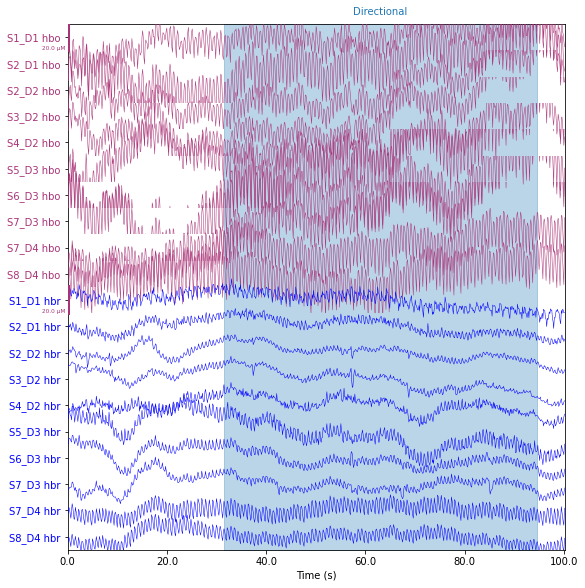

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


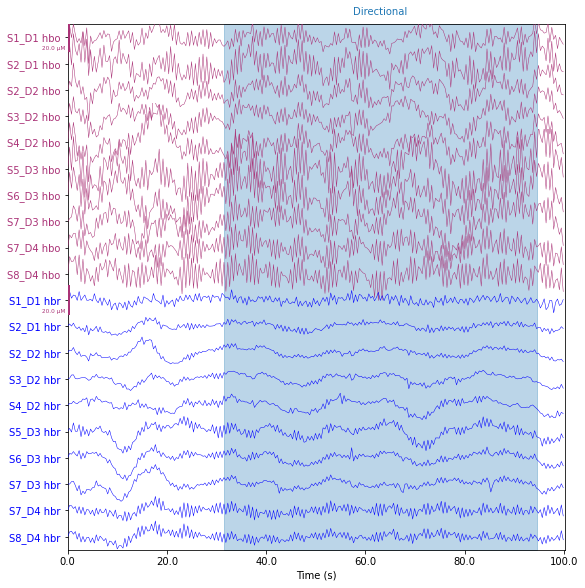

haemo


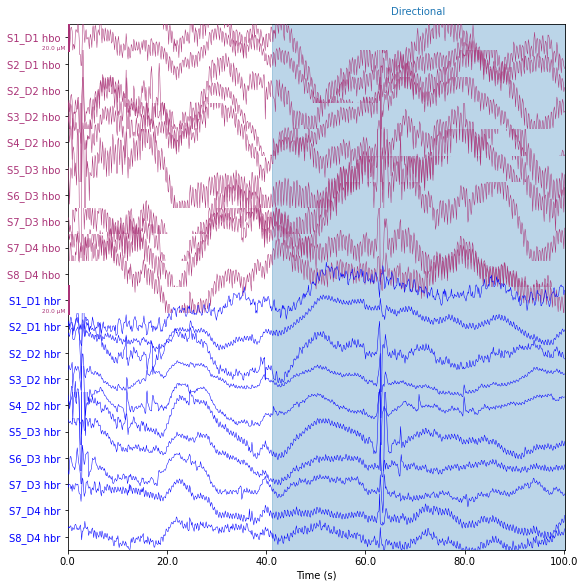

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


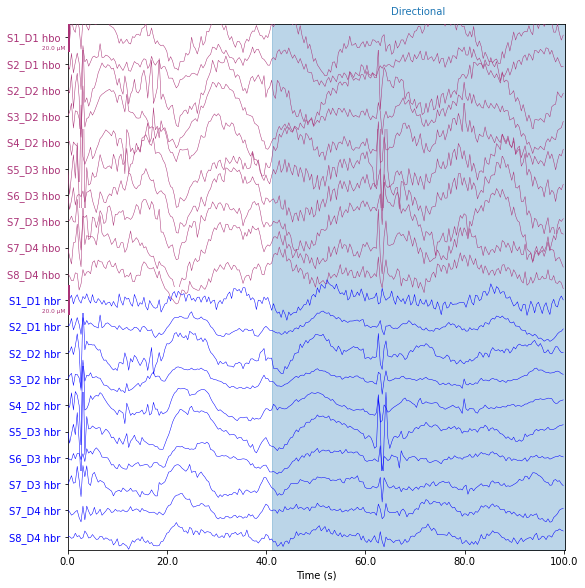

haemo


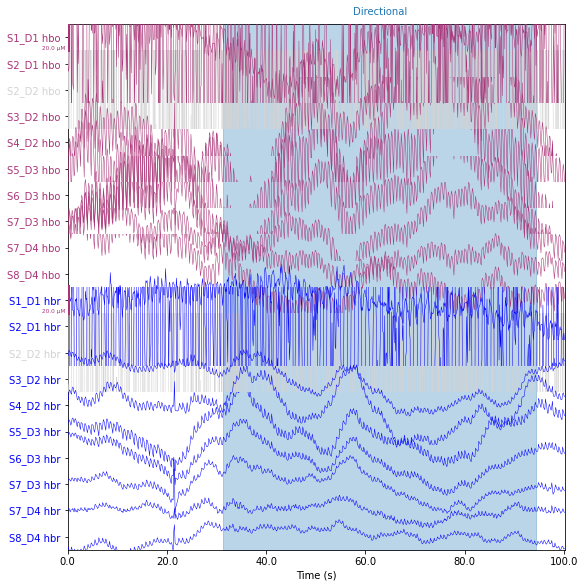

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


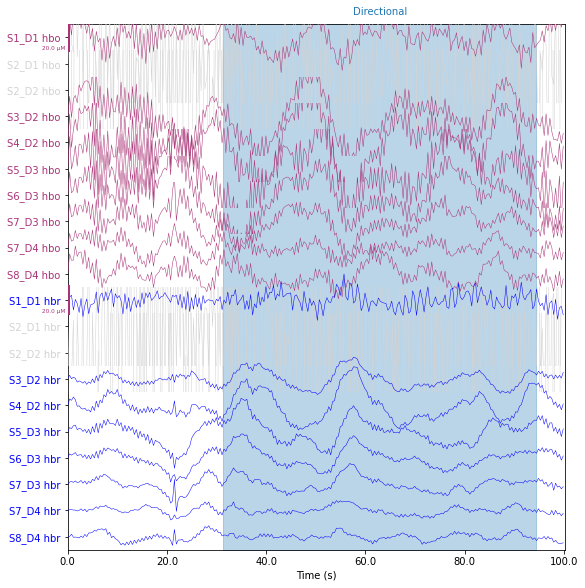

haemo


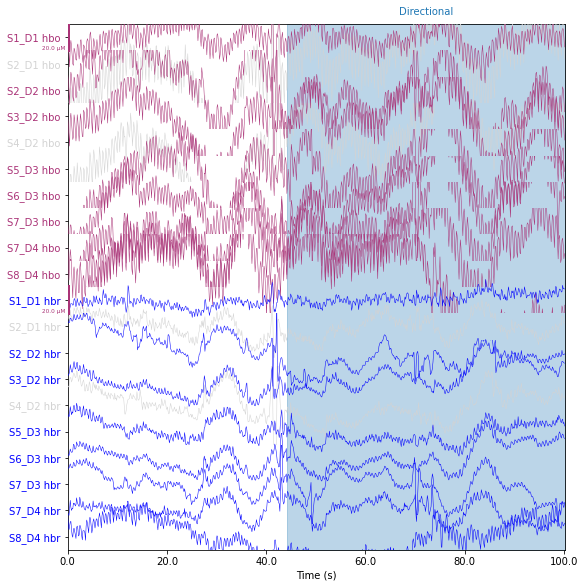

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


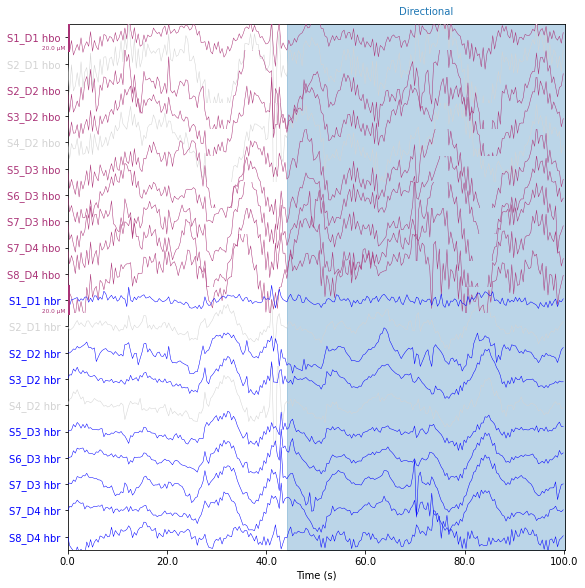

haemo


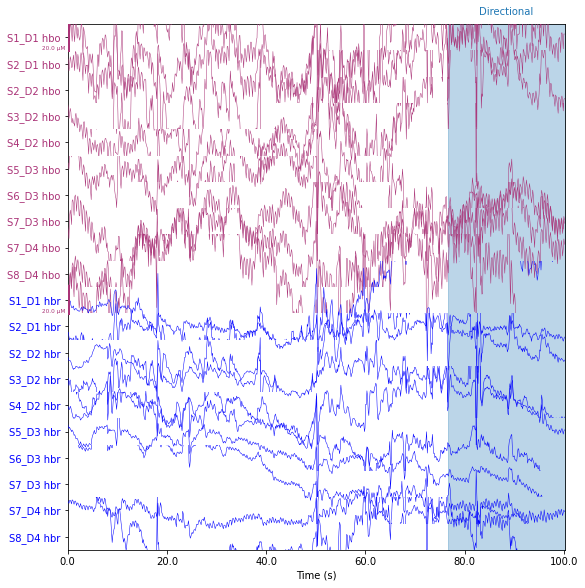

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


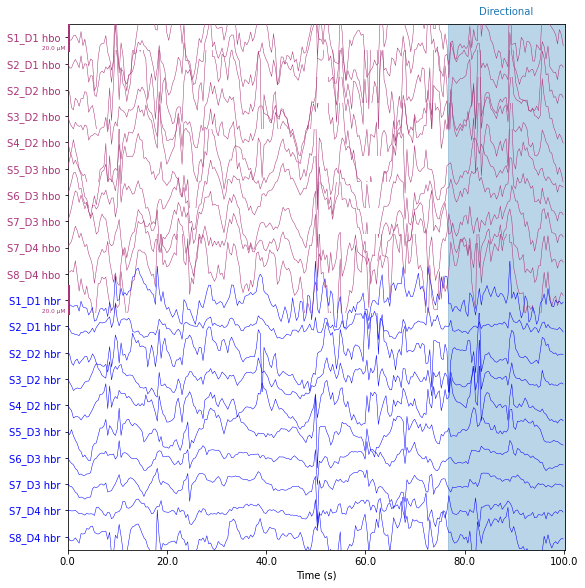

haemo


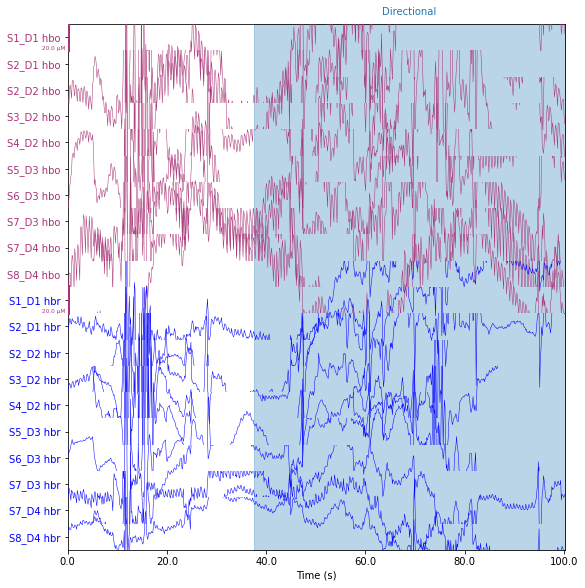

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


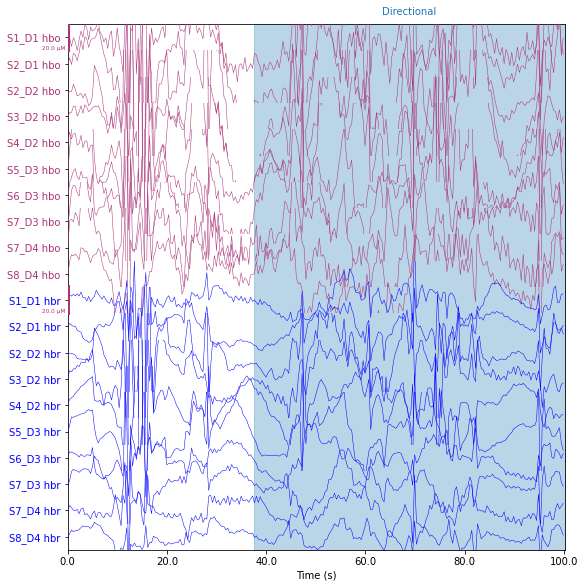

haemo


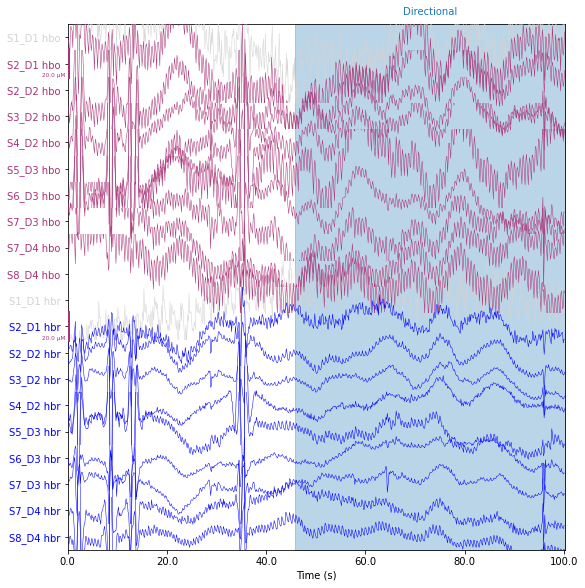

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


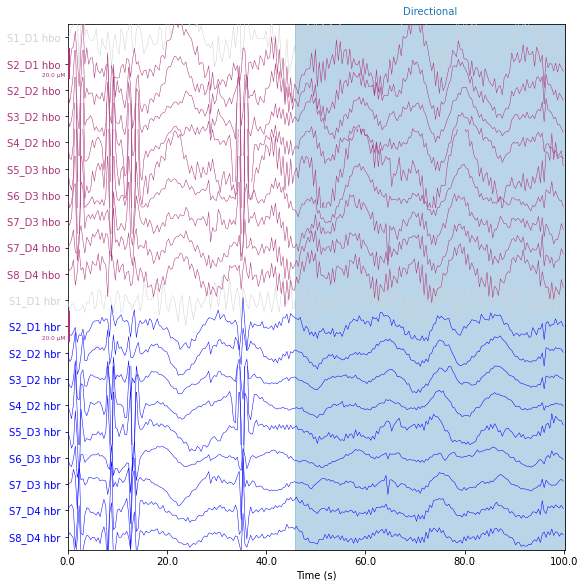

haemo


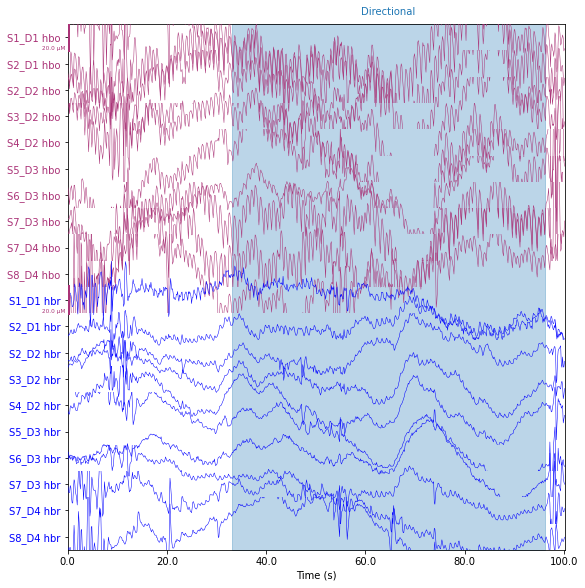

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


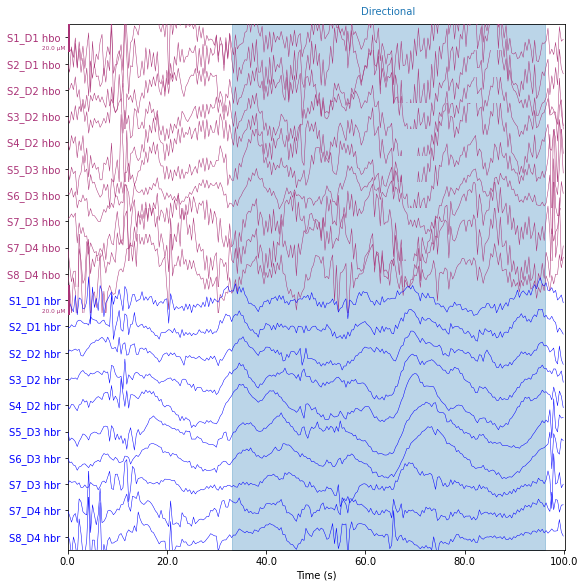

haemo


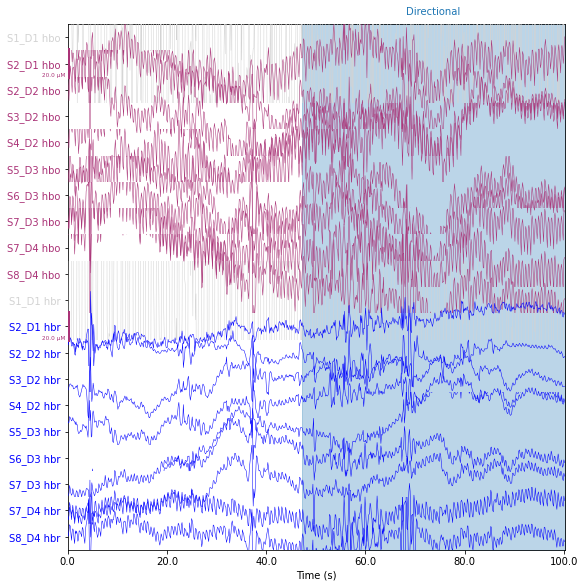

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


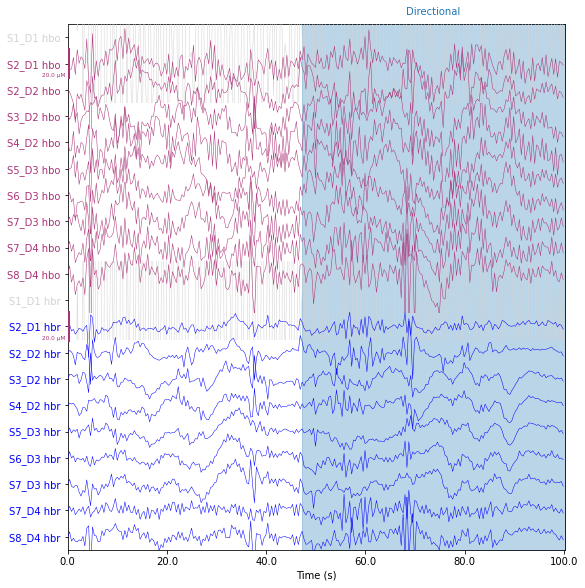

haemo


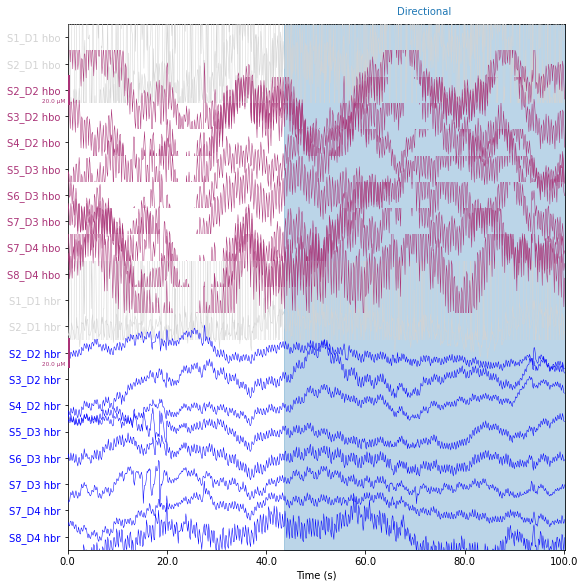

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


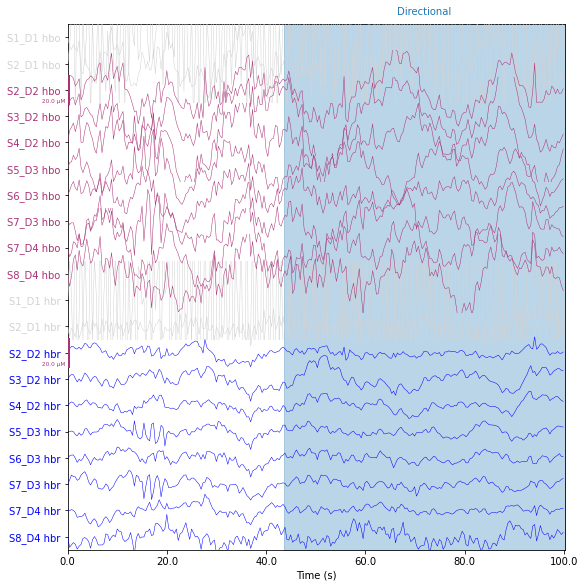

haemo


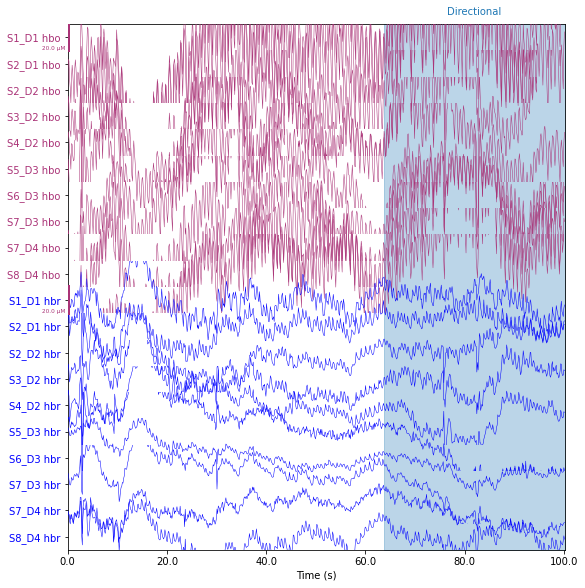

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


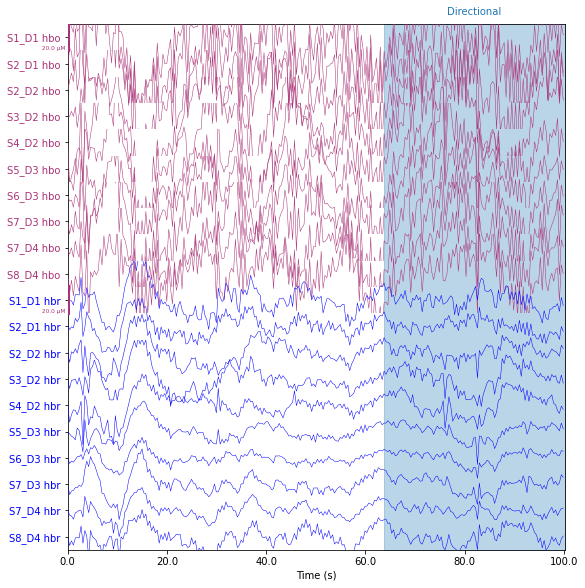

haemo


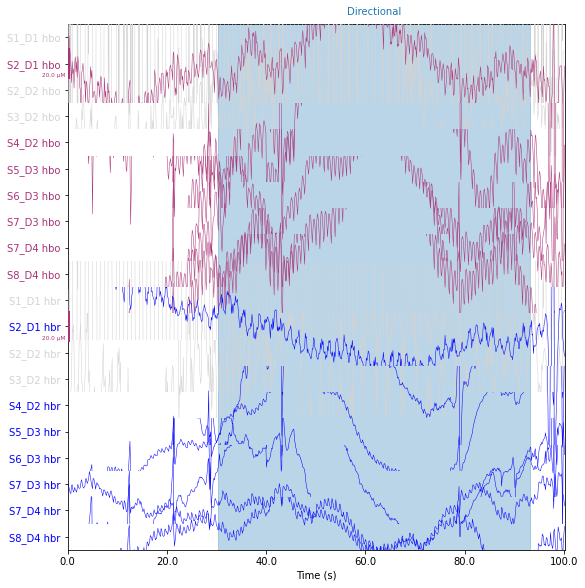

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


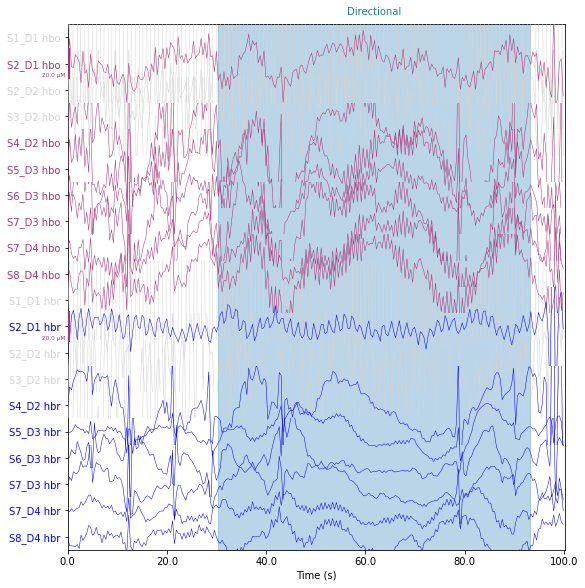

haemo


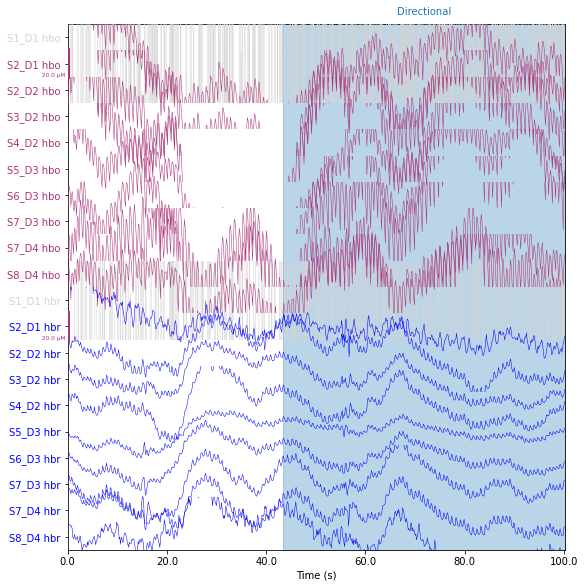

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


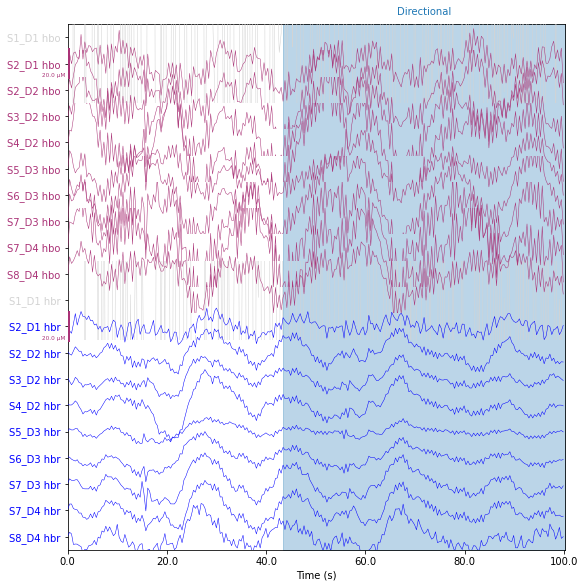

haemo


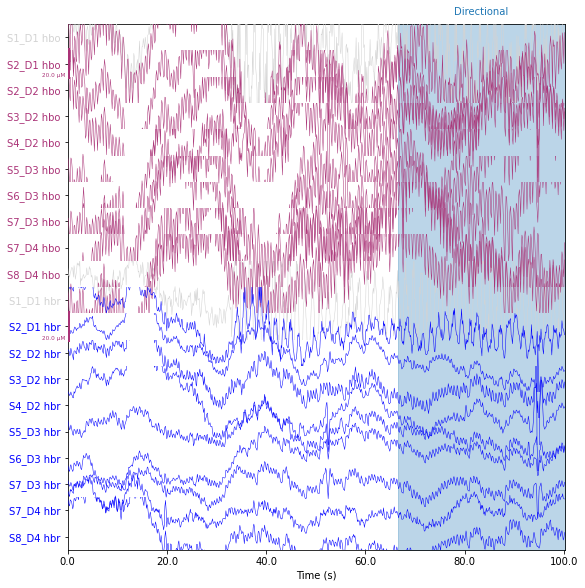

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


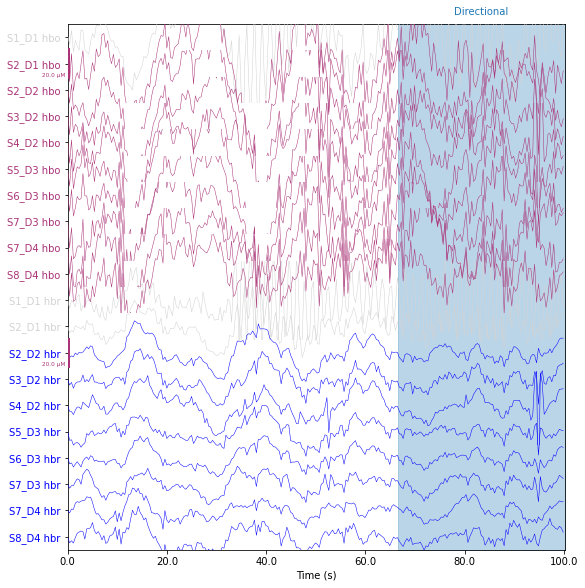

haemo


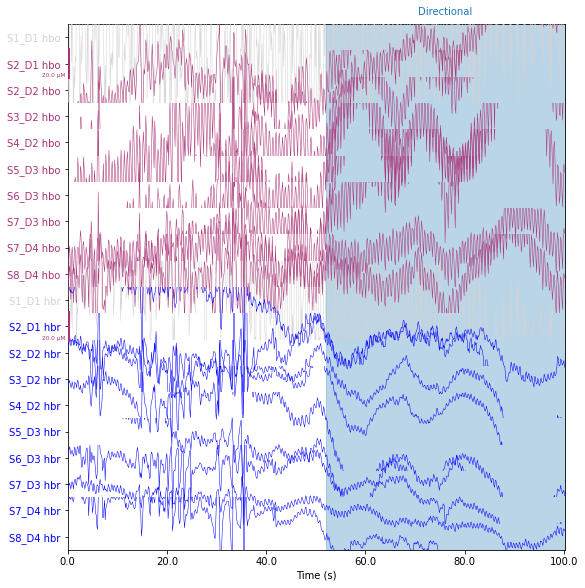

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


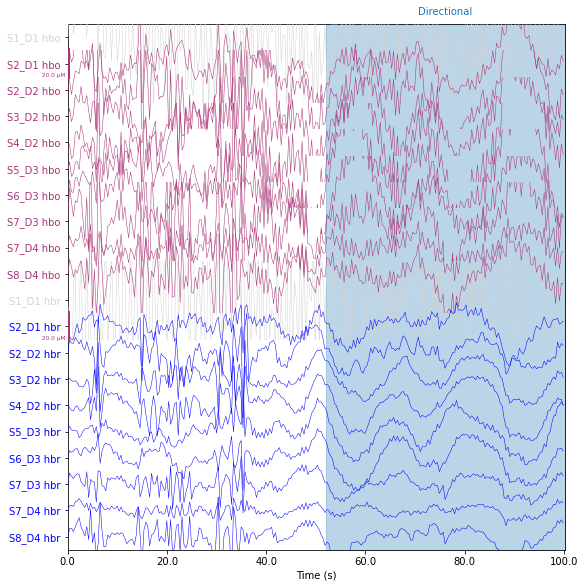

haemo


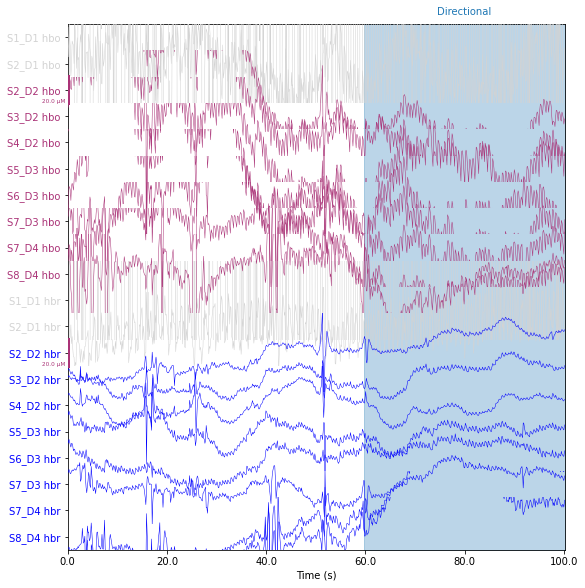

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


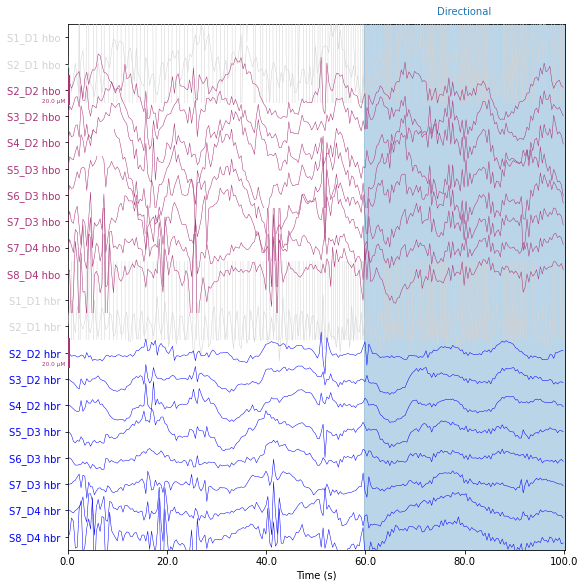

haemo


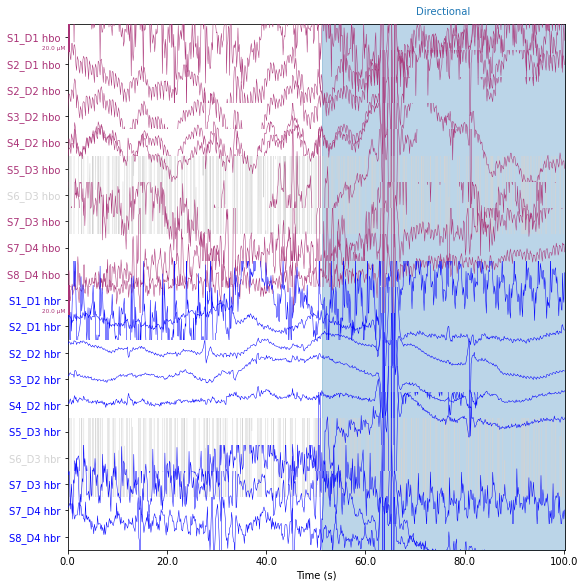

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


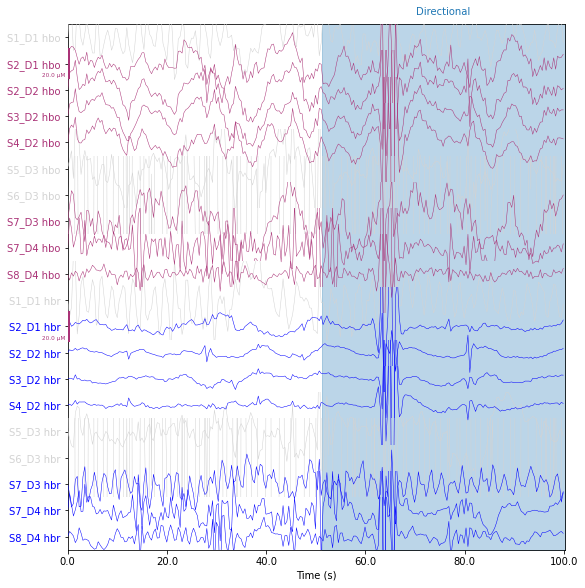

haemo


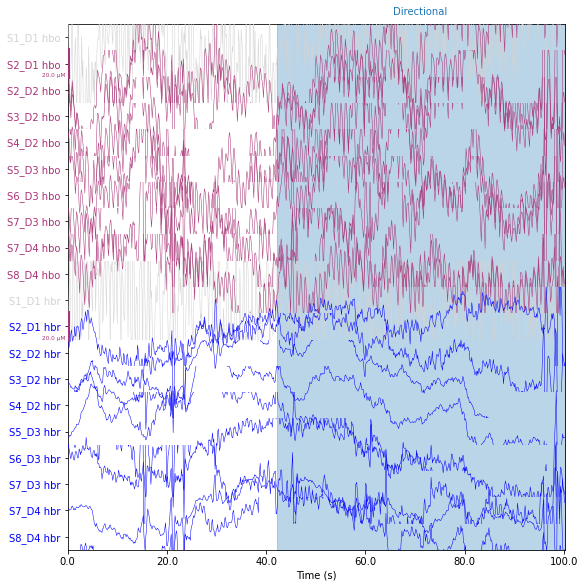

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


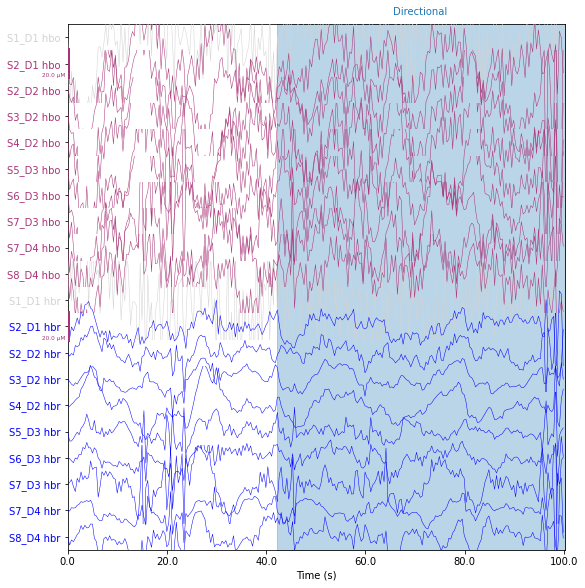

haemo


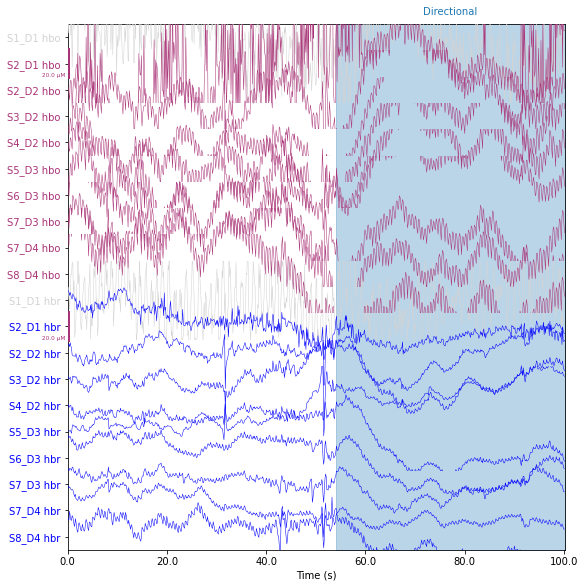

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


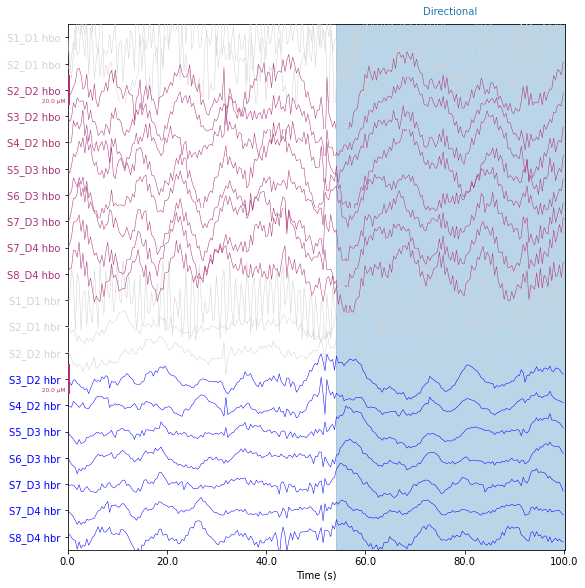

haemo


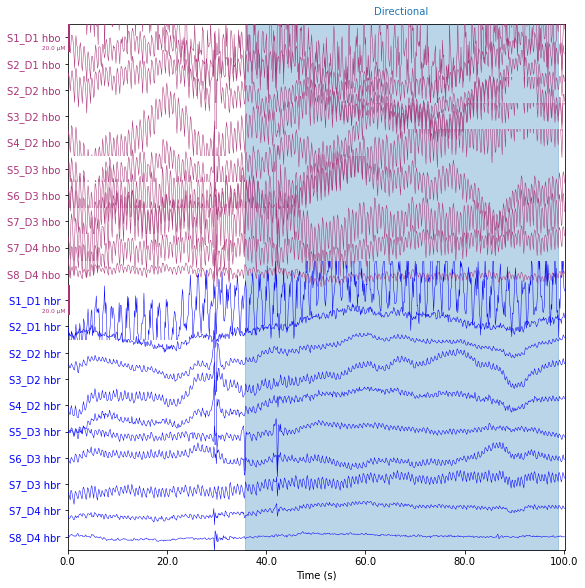

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


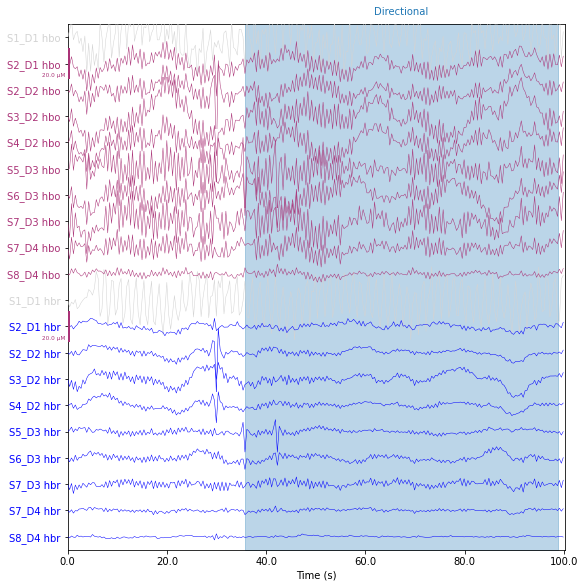

haemo


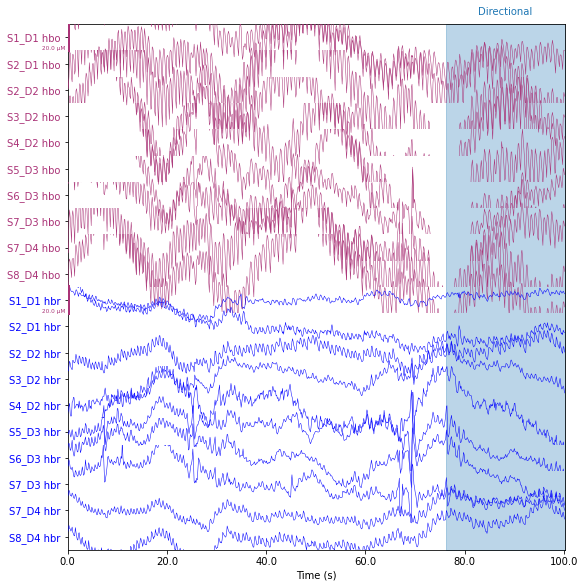

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


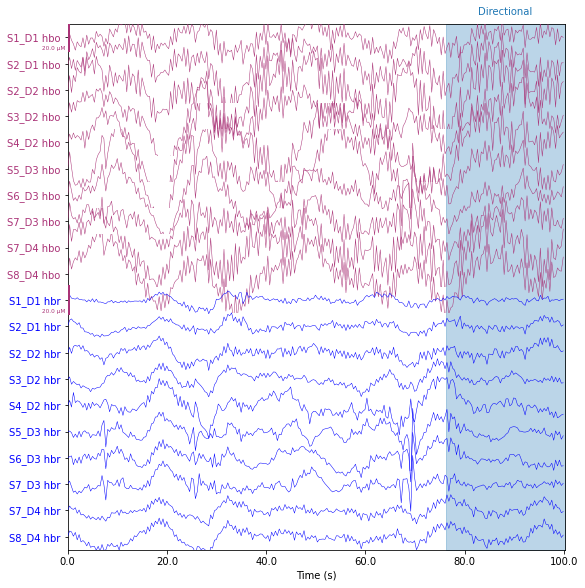

haemo


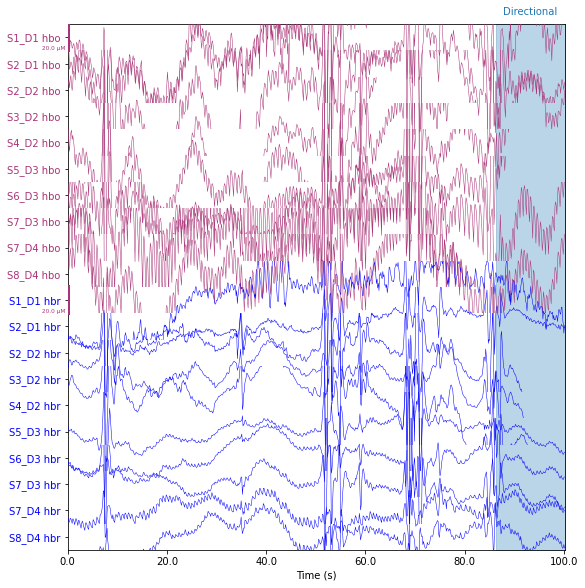

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


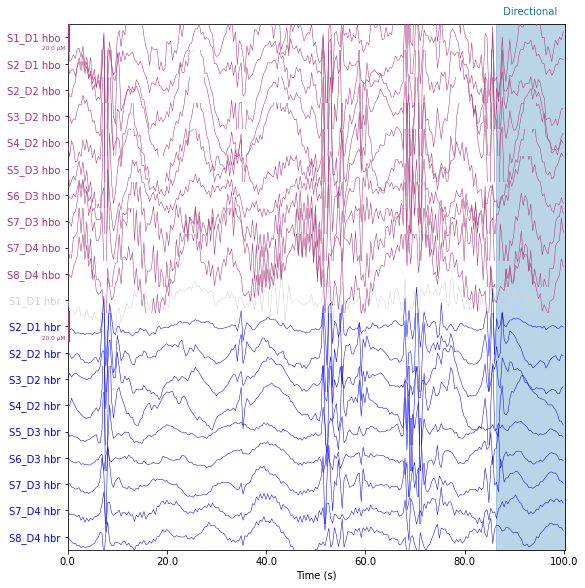

haemo


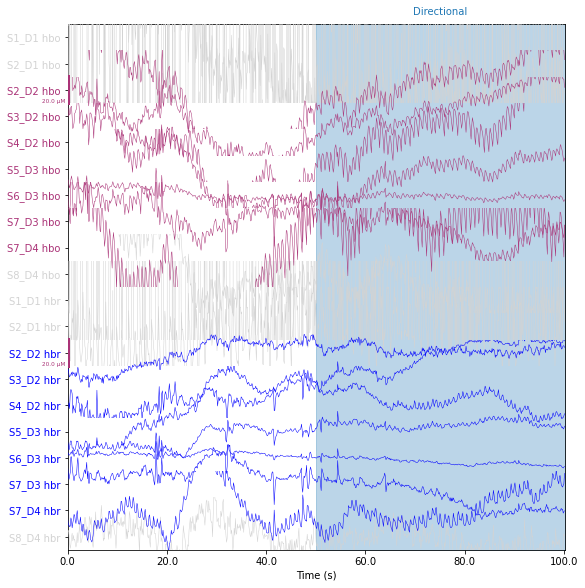

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


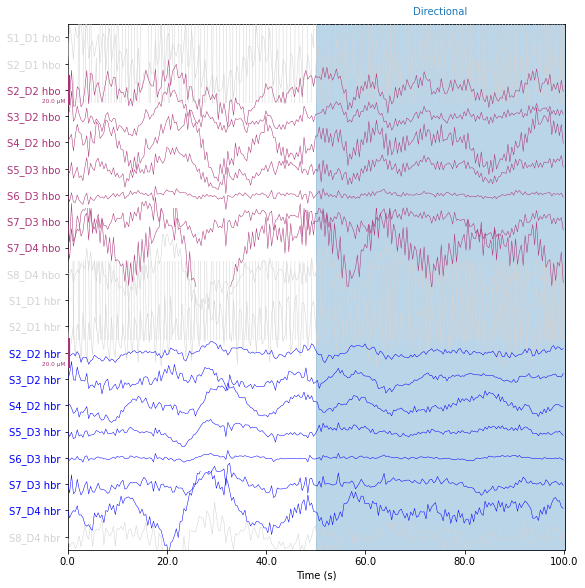

haemo


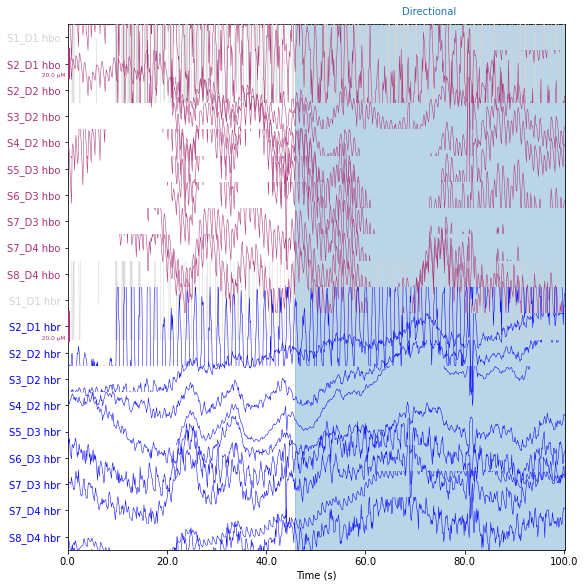

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


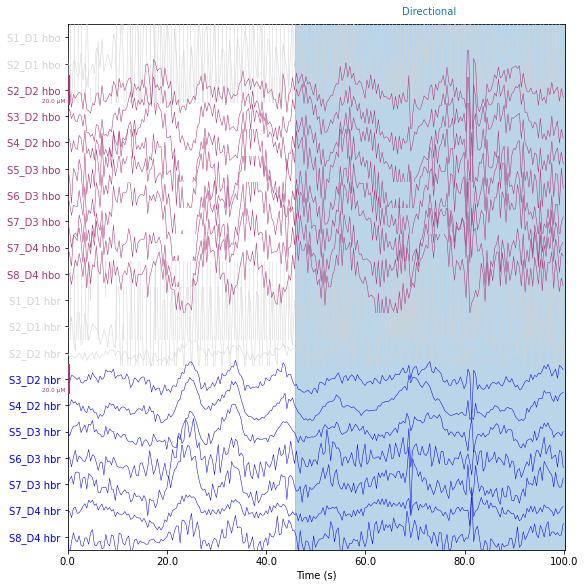

haemo


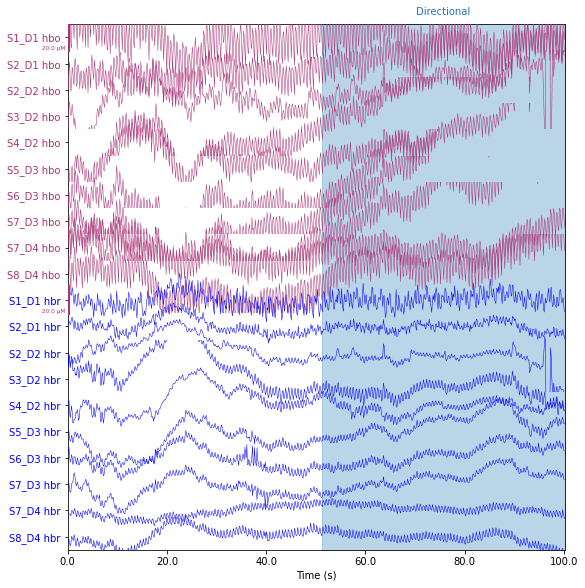

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


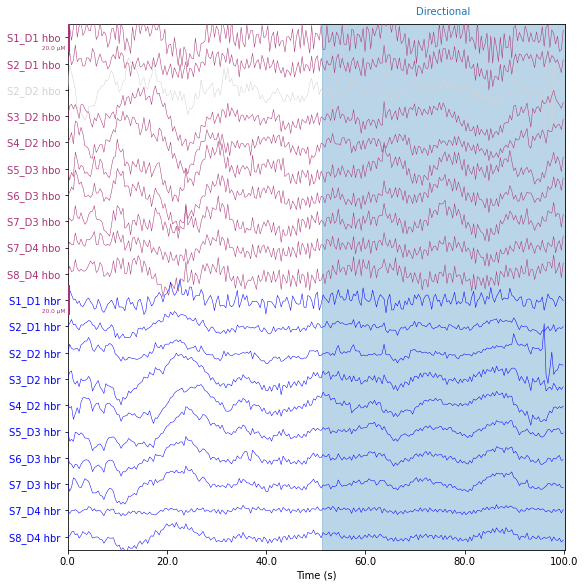

haemo


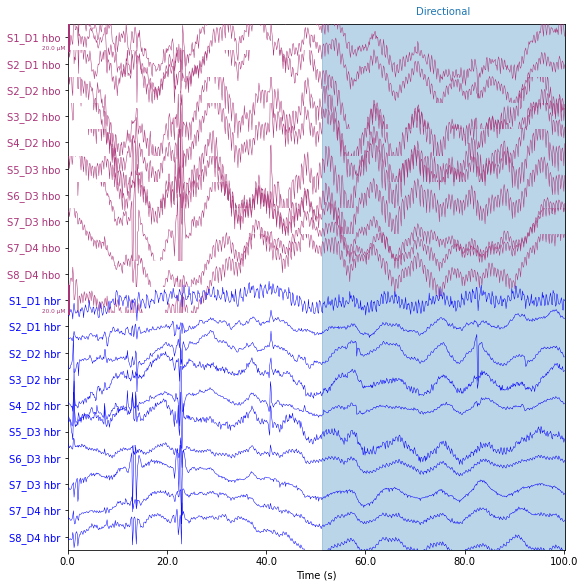

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


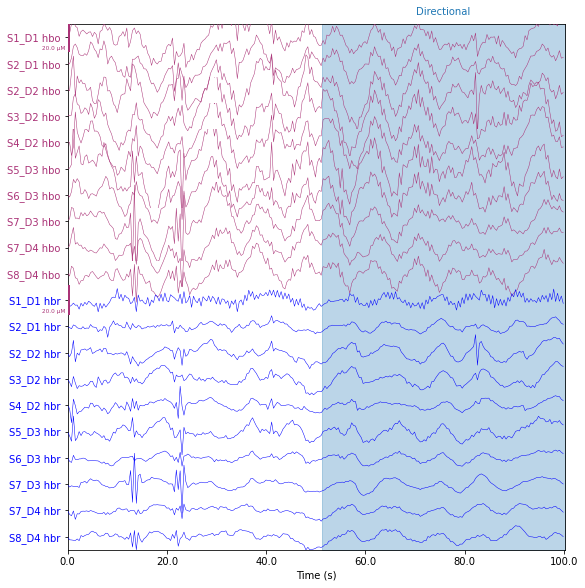

haemo


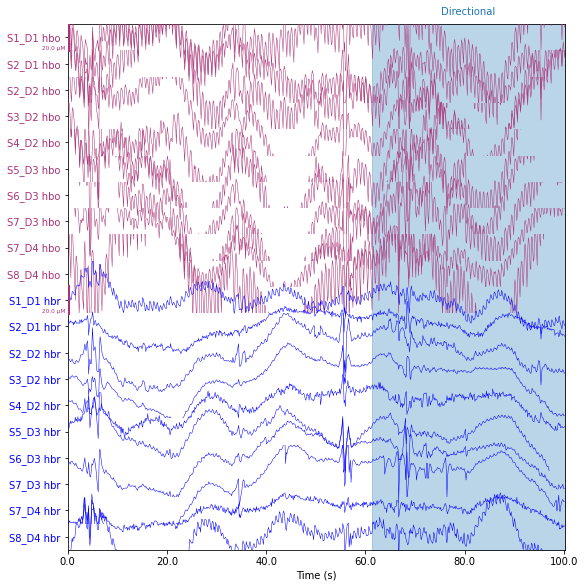

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


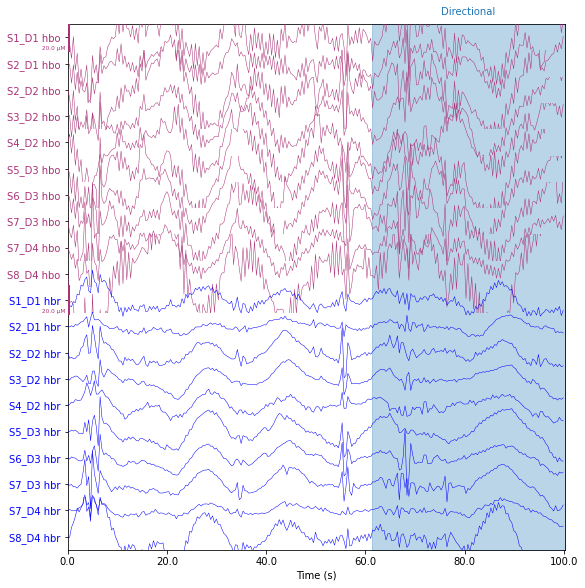

haemo


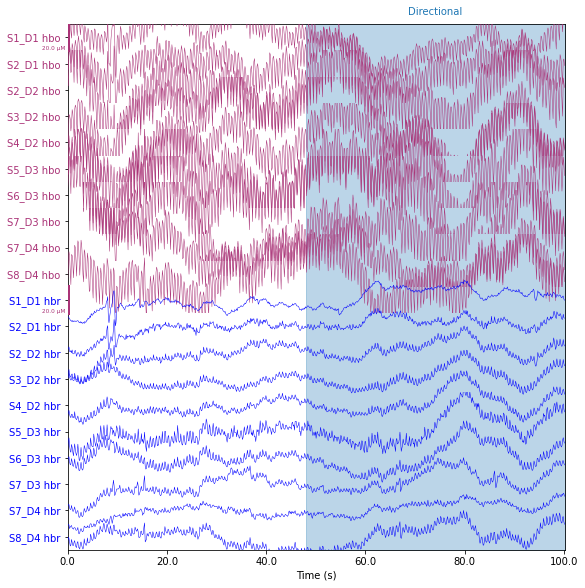

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


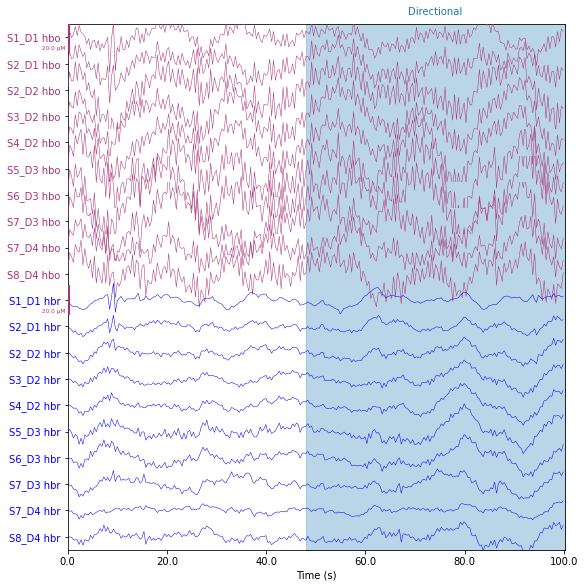

haemo


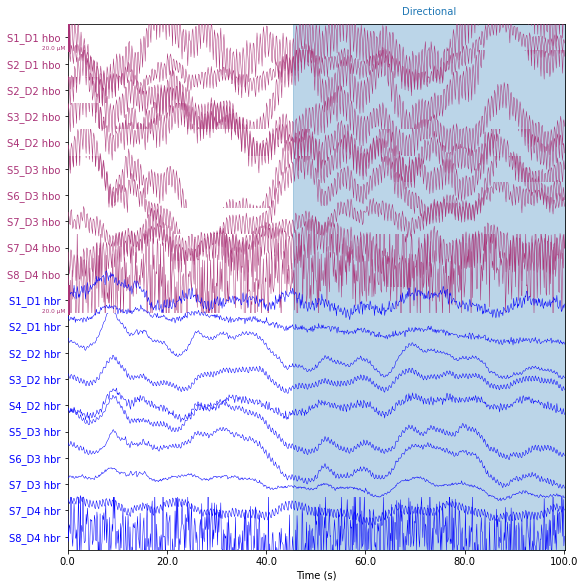

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


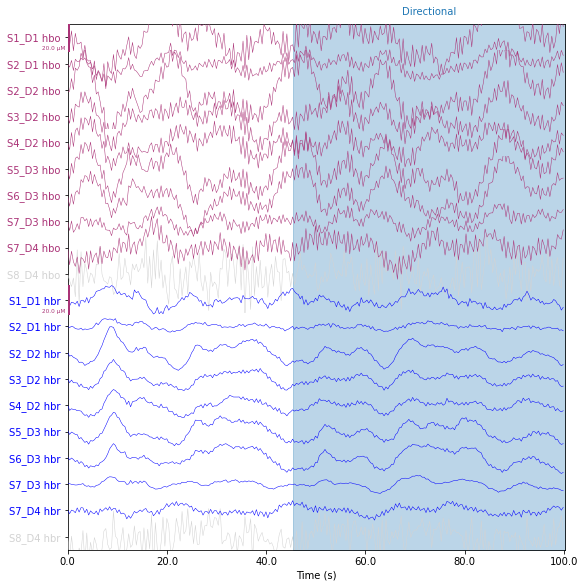

haemo


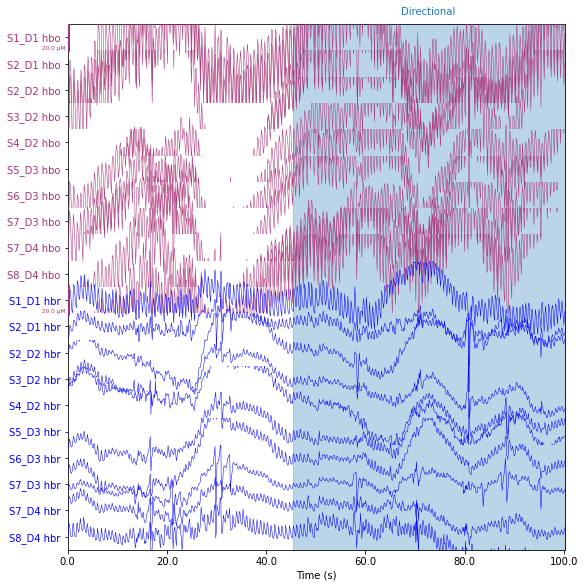

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


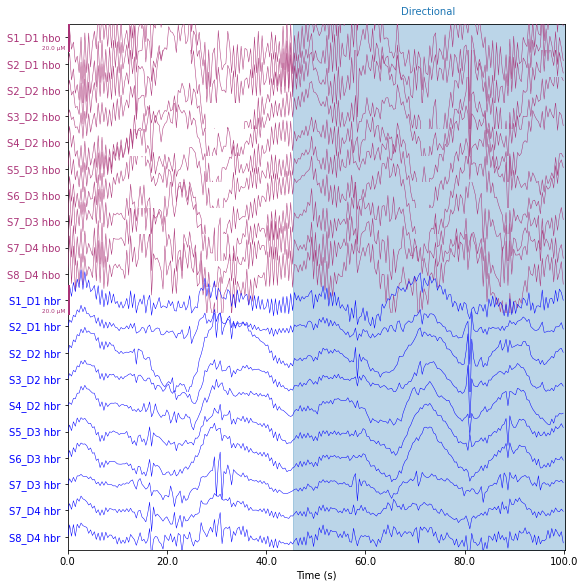

haemo


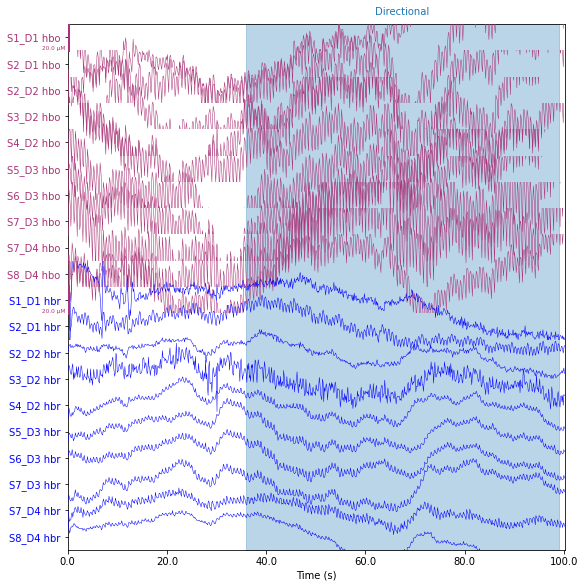

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


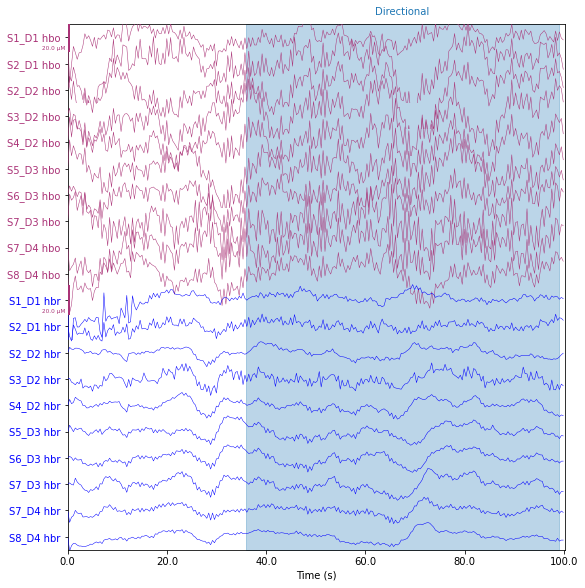

haemo


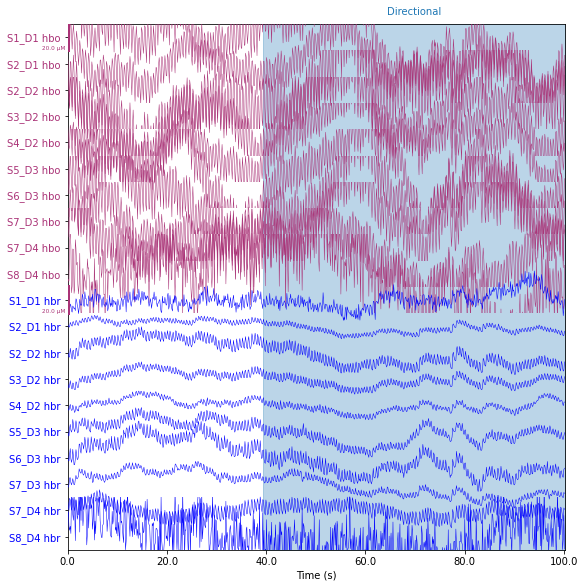

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


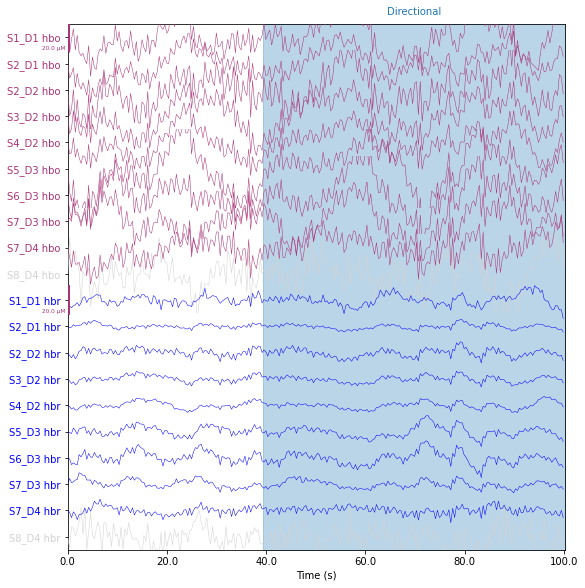

haemo


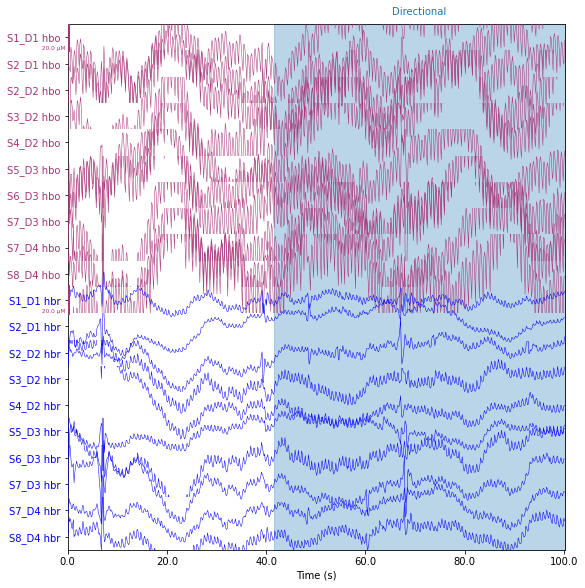

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


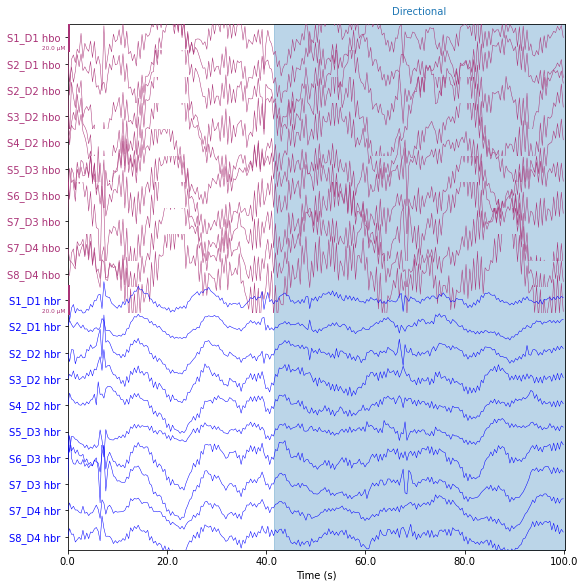

haemo


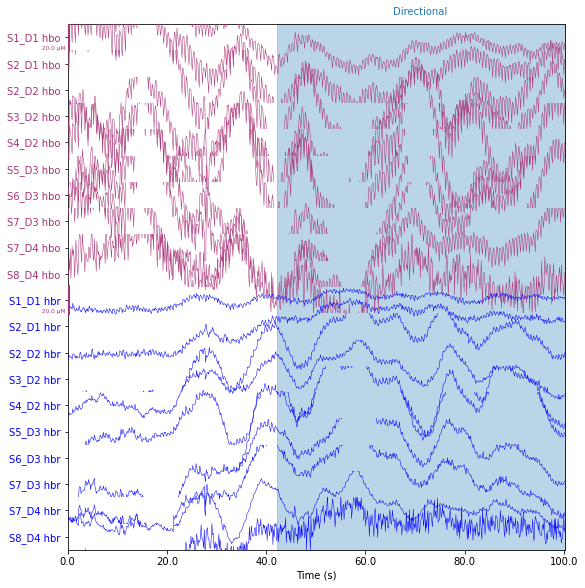

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


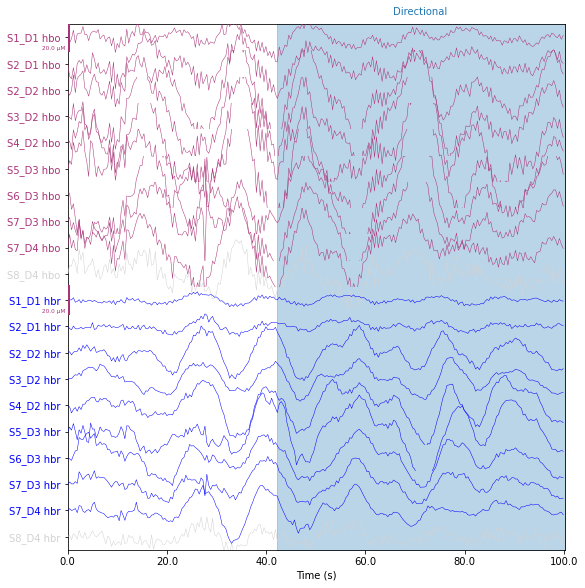

haemo


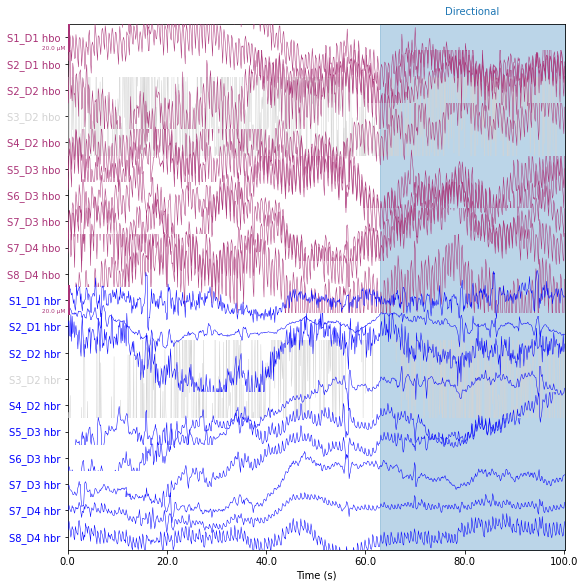

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


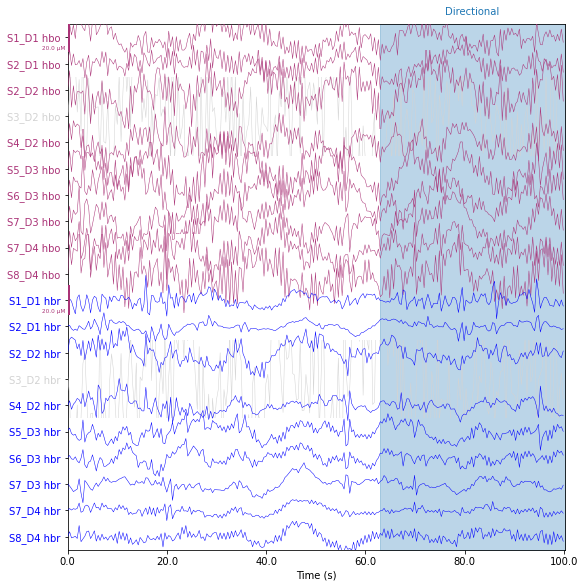

haemo


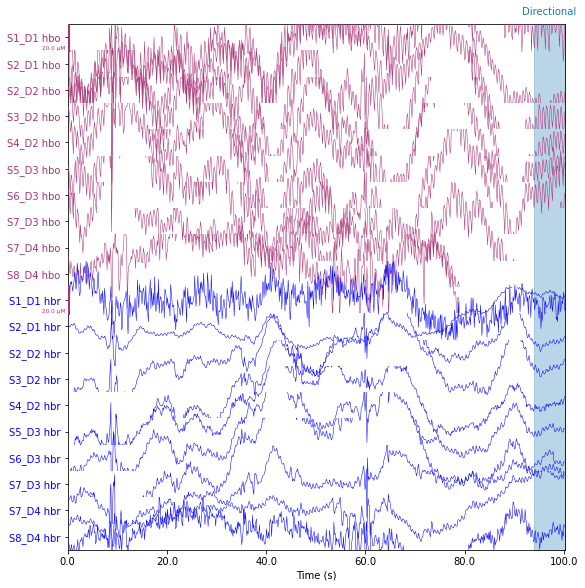

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


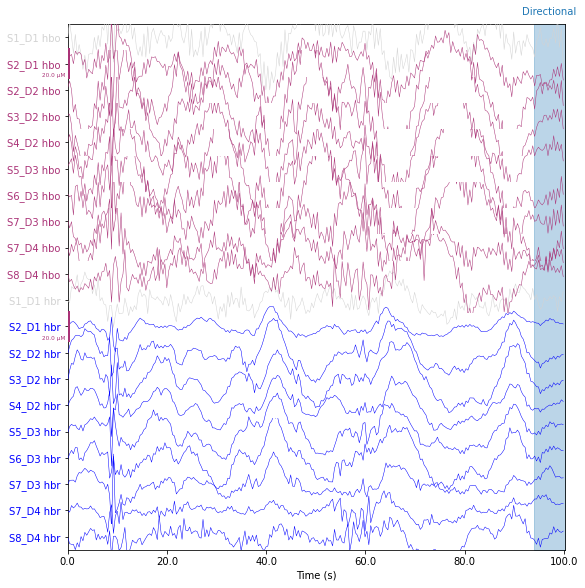

haemo


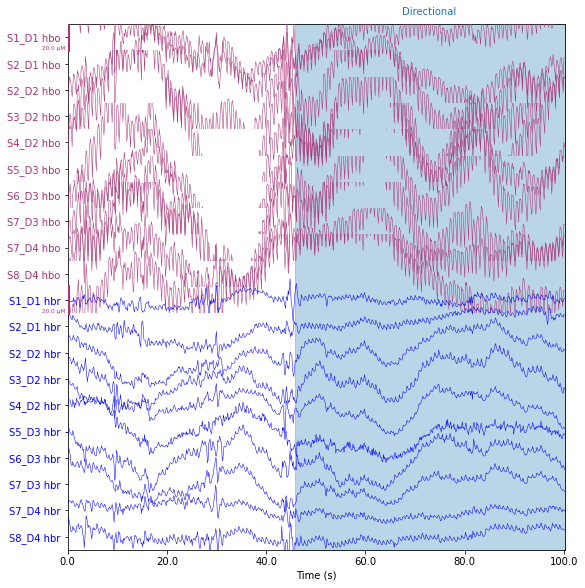

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


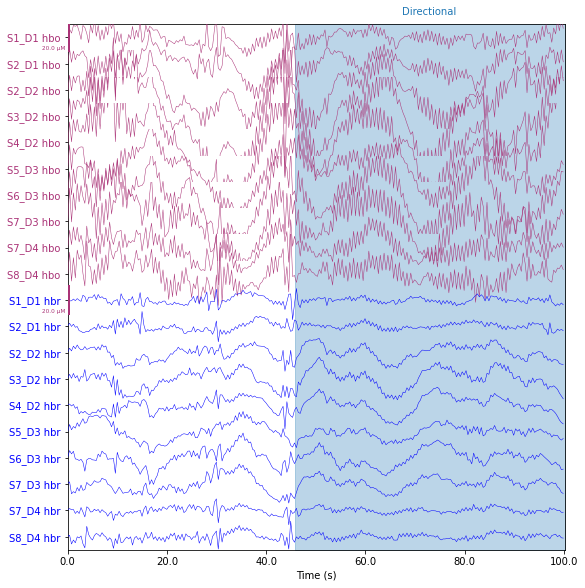

haemo


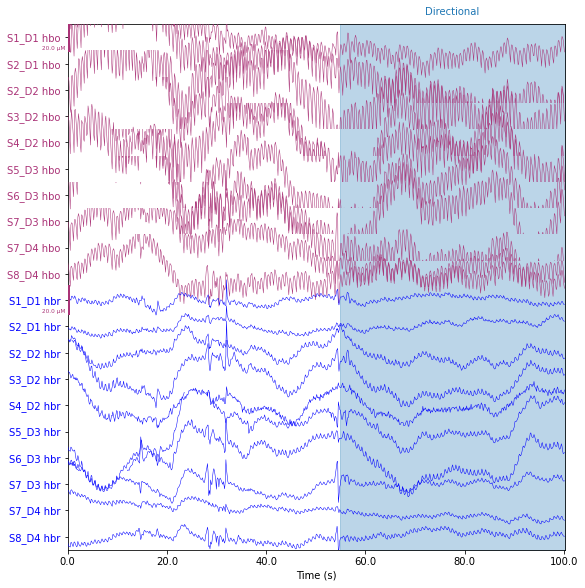

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


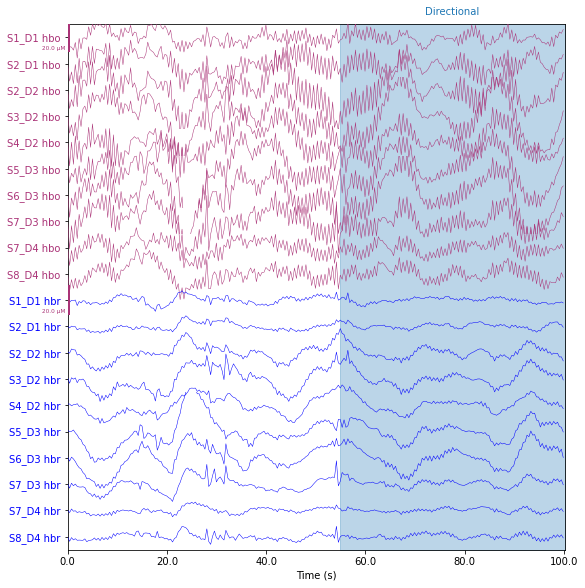

haemo


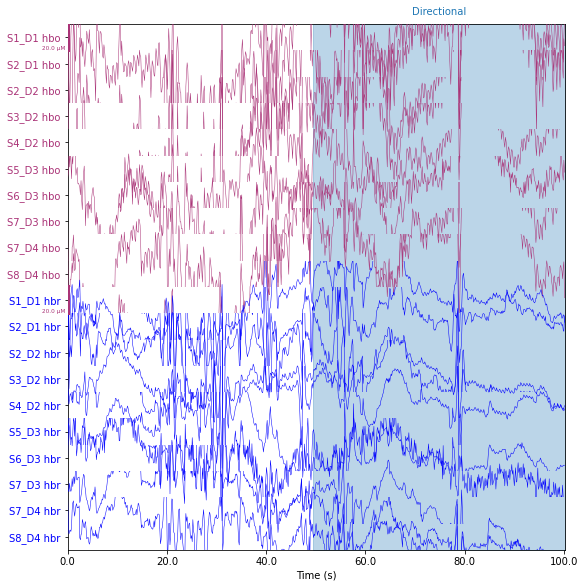

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


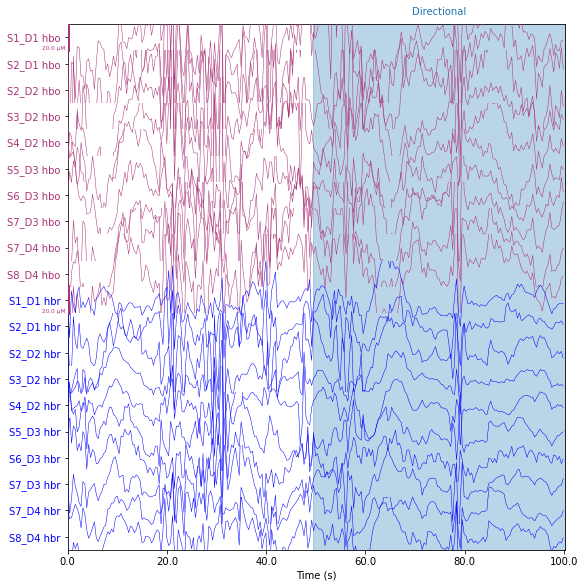

haemo


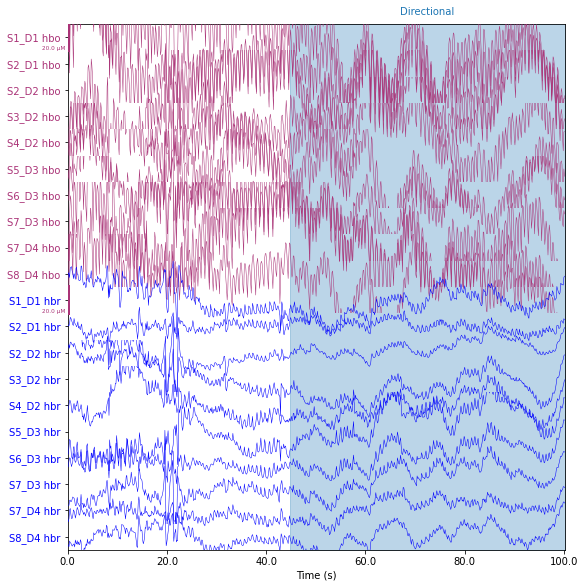

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


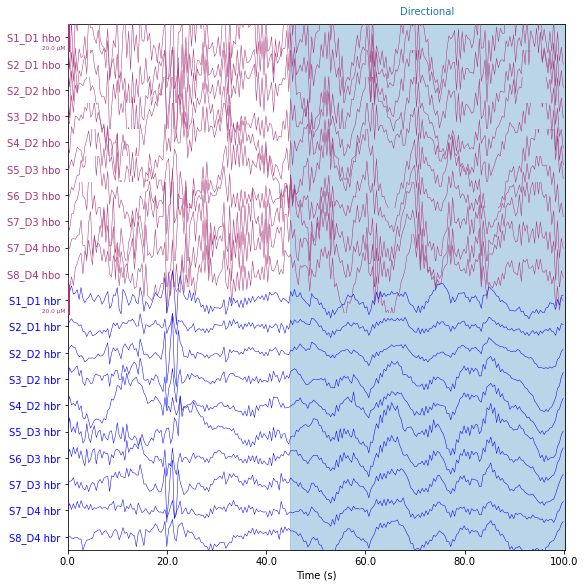

haemo


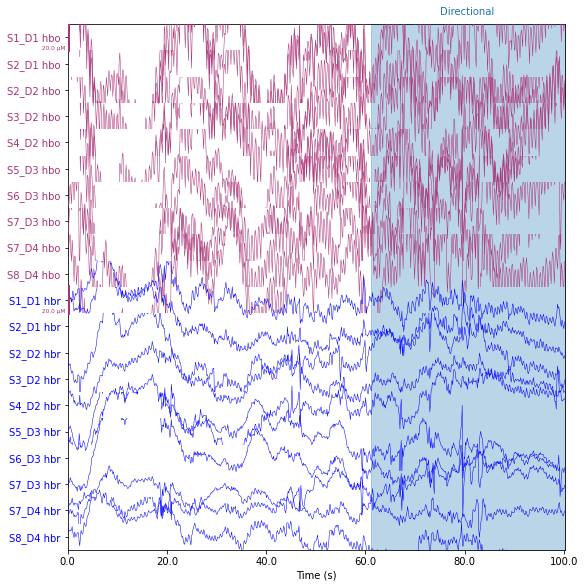

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


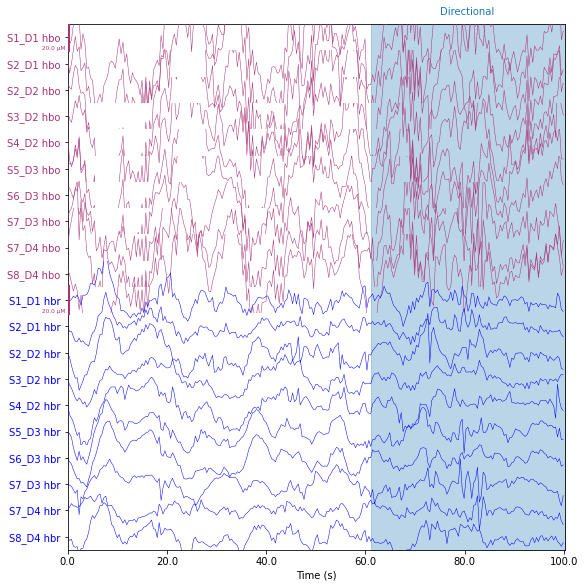

haemo


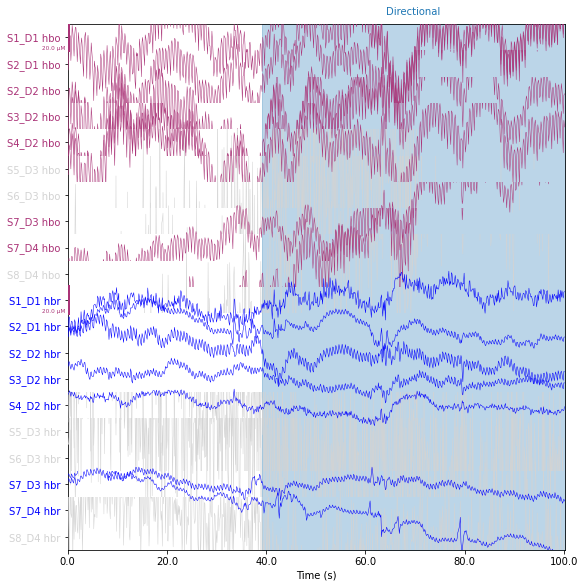

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


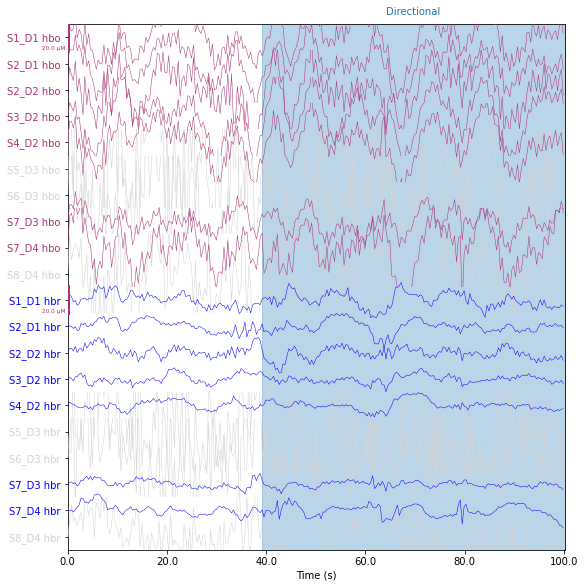

haemo


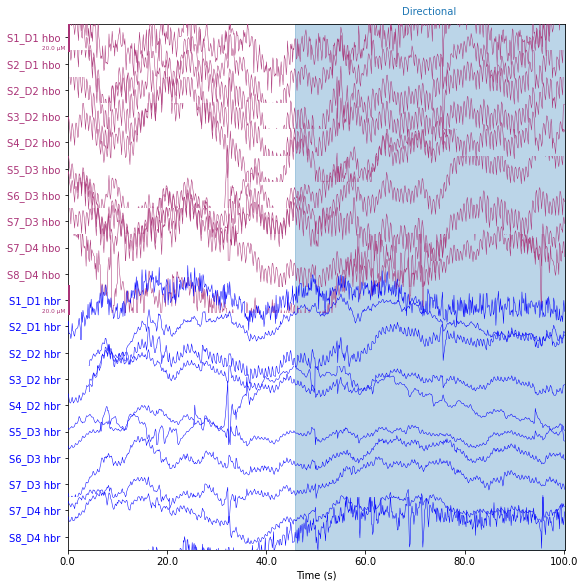

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


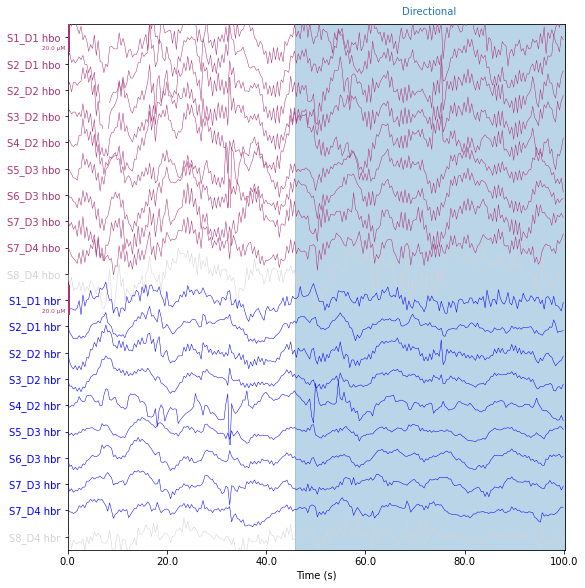

haemo


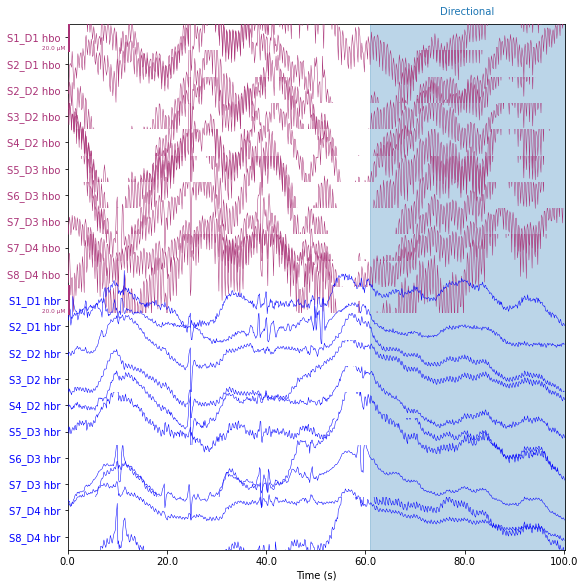

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


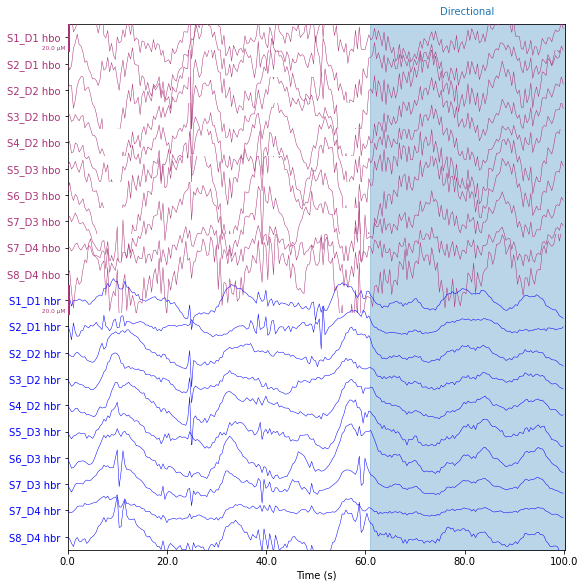

haemo


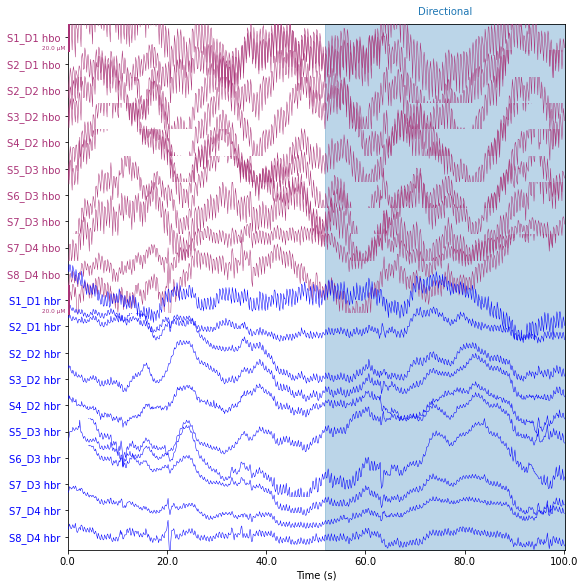

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


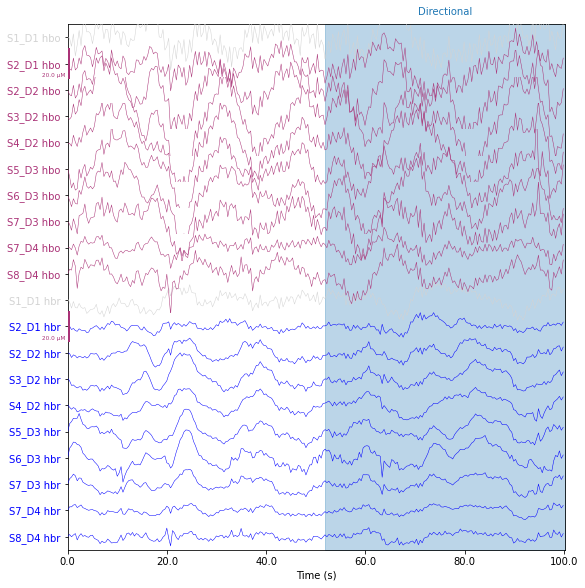

haemo


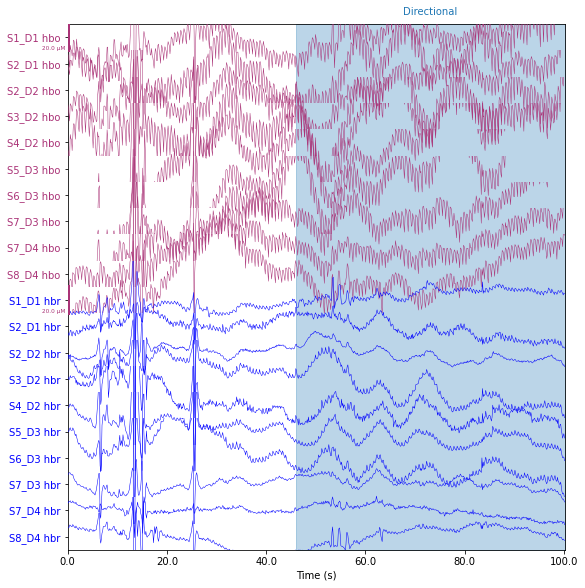

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


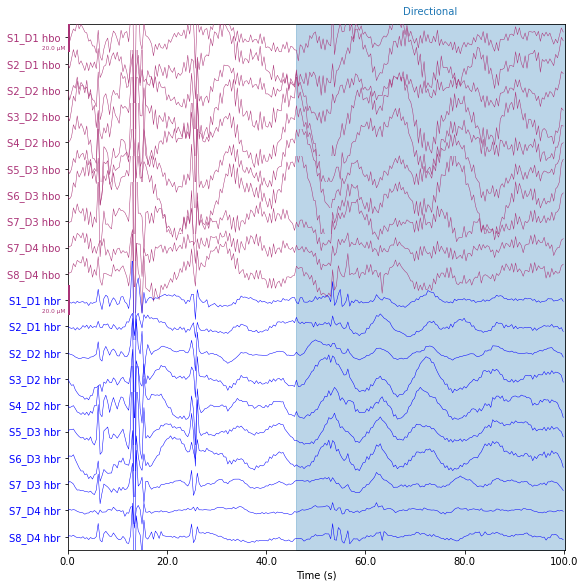

haemo


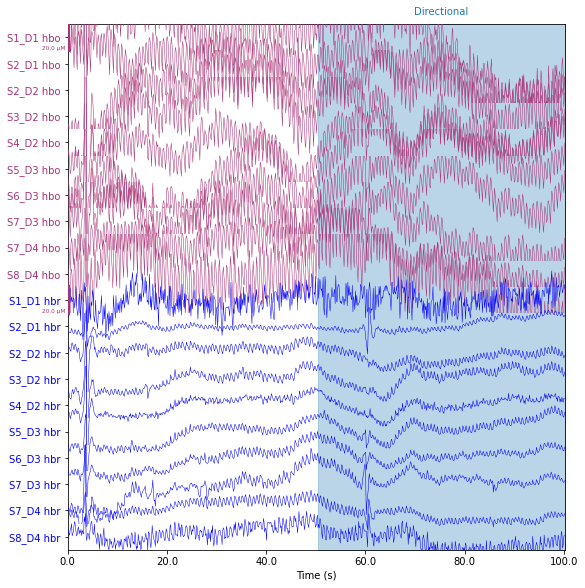

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.05 - 0.7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 0.70 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.70 Hz)
- Filter length: 517 samples (66.176 sec)

0.05 - 0.7 Hz bandpass


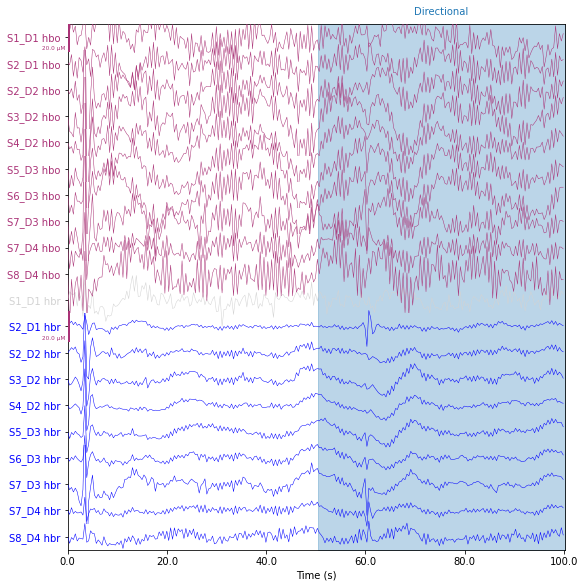

In [45]:
# make a new list where all of the preprocessed mne.io.raw NIRS objects will go
pp_haemos = []

# %matplotlib inline
# %matplotlib widget

# loop over the event-edited versions
for raw_ints in evt_ints:
    
    subject = raw_ints.info['subject_info']['his_id'][:participant_num_len]
    
    # convert to optical density
    raw_od = mne.preprocessing.nirs.optical_density(raw_ints)
    
    sci = mne.preprocessing.nirs.scalp_coupling_index(raw_od) # scalp coupling index
    
    raw_od.info['bads'] = list(compress(raw_od.ch_names, sci < 0.5)) # add the bad channels from SCI to their info
    
    # temporal derivative distribution repair (motion attempt)
    tddr_od = mne.preprocessing.nirs.tddr(raw_od)

    # haemoglobin conversion
    haemo = mne.preprocessing.nirs.beer_lambert_law(tddr_od, ppf=0.1)
    print("haemo")
    haemo.plot(
        n_channels=len(haemo.ch_names),
        duration=100,
        show_scrollbars=False)

    # add bad channels from list curated by 
    # Emily and Clayton
    for ch in bad_channels[subject]:
        if ch not in haemo.info['bads']:
            haemo.info['bads'].append(ch)
    
    # band pass filter
    haemo_lp = haemo.copy().filter(0.05, 0.7) 
    print("0.05 - 0.7 Hz bandpass")
    haemo_lp.plot(
        n_channels=len(haemo_lp.ch_names),
        duration=100,
        show_scrollbars=False)
    
    # plot 500 seconds of data
#     haemo_lp.plot(
#         n_channels=len(haemo.ch_names),
#         duration=100,
#         show_scrollbars=False)
    
    pp_haemos.append(haemo_lp)

In [46]:
# just print out all of the NIRx IDs (from NIRStar entries)
ids = []
for raw in pp_haemos:
    ids.append(raw.info['subject_info']['his_id'])
ids.sort()
length = 0
for id in ids:
    if id[:2] == '12':
        print(id)
        length +=1
print(length)

1202
1204
1207
1209
1211
1213
1219
1220
1223
1226
1235-Child
1236
1238
1239-Child
1243
1244
1246
1247
1251-C
1253
1254-child
21


In [47]:
events, event_dict = mne.events_from_annotations(haemo)

Used Annotations descriptions: ['Directional', 'Indirectional']


In [48]:
list(event_dict.items())

[('Directional', 1), ('Indirectional', 2)]

Used Annotations descriptions: ['Directional', 'Indirectional']
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 532 original time points ...
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
2 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 286 original time points ...
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
3 bad epochs dropped
Not setting metadata
Not setting metadata
3 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting

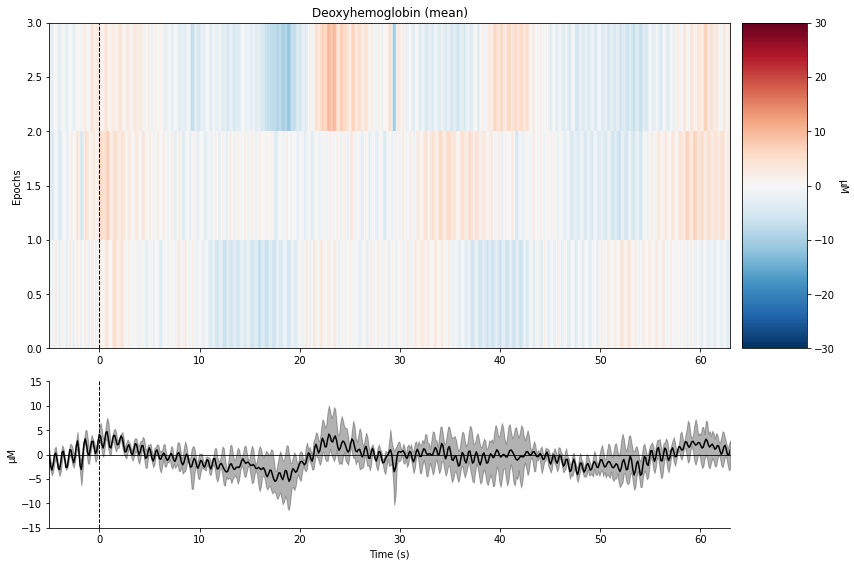

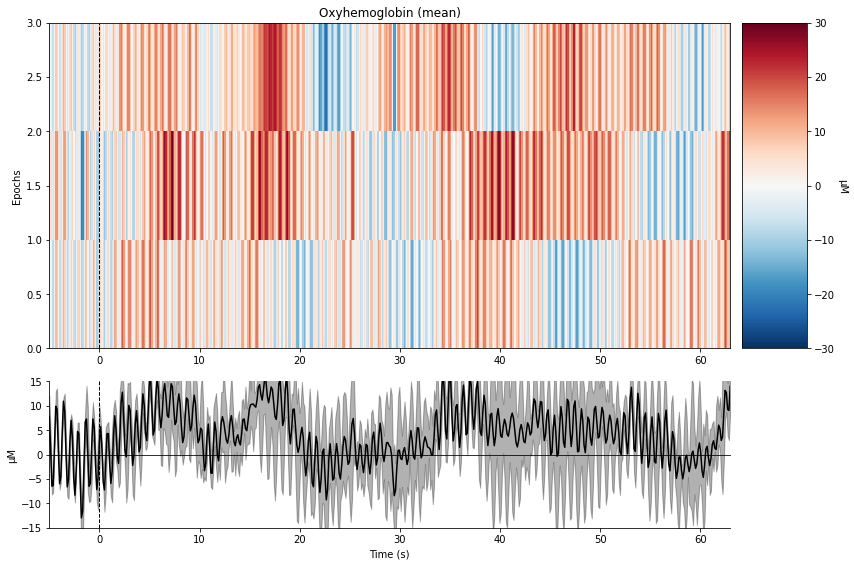

Not setting metadata
Not setting metadata
2 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
2 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


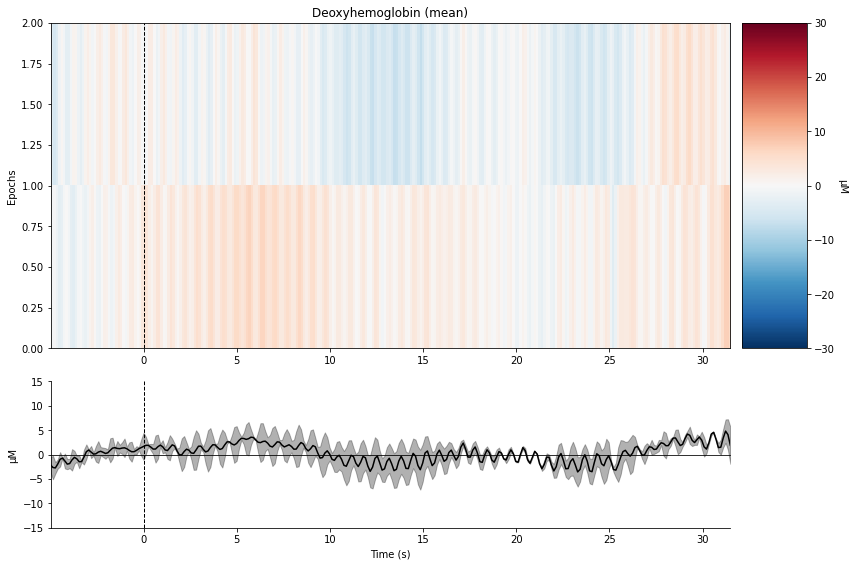

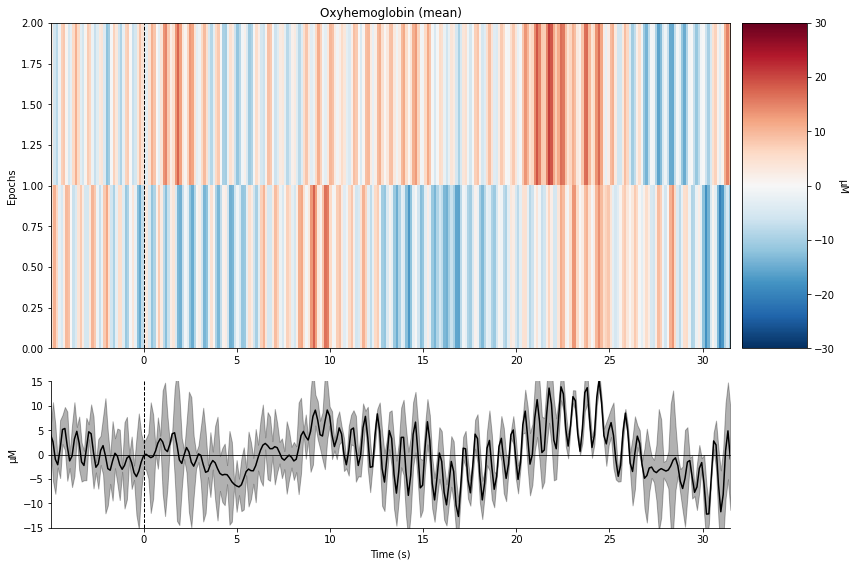

Used Annotations descriptions: ['Directional', 'Indirectional']
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 532 original time points ...
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
2 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 286 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
3 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
3 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining chan

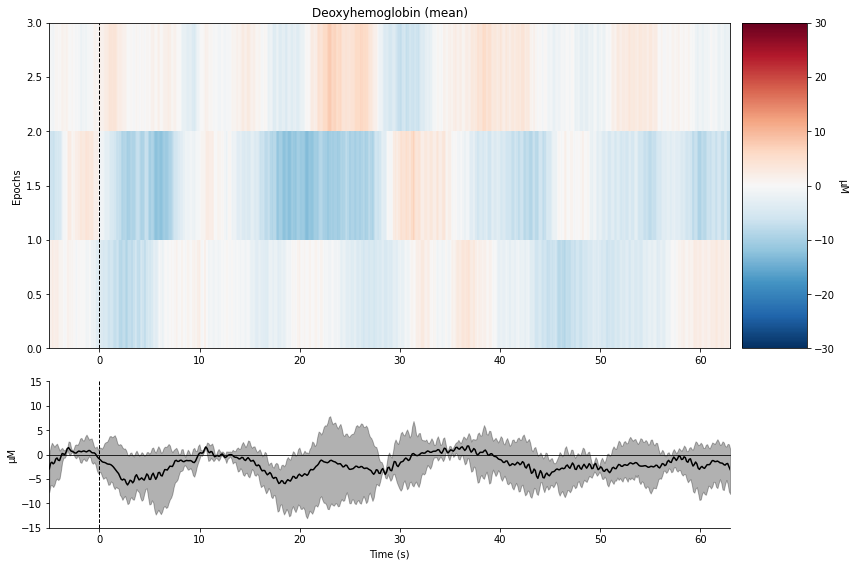

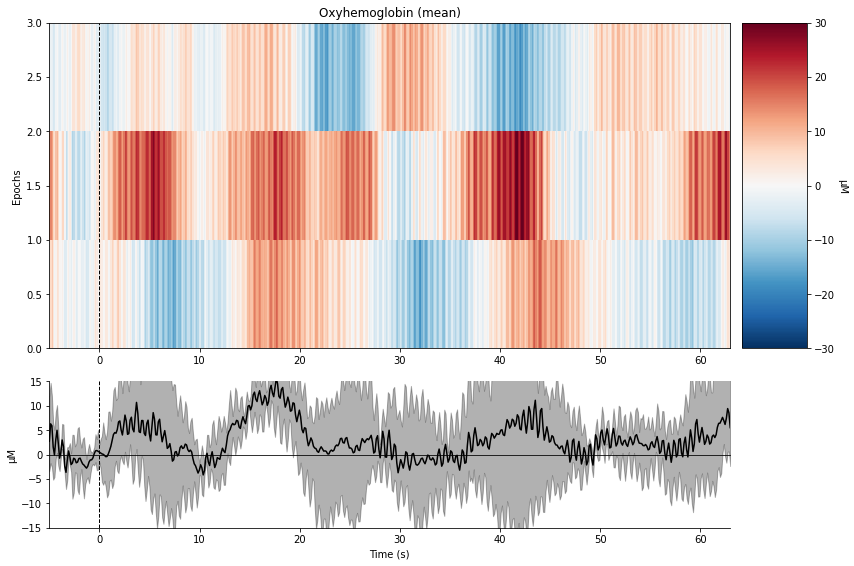

Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


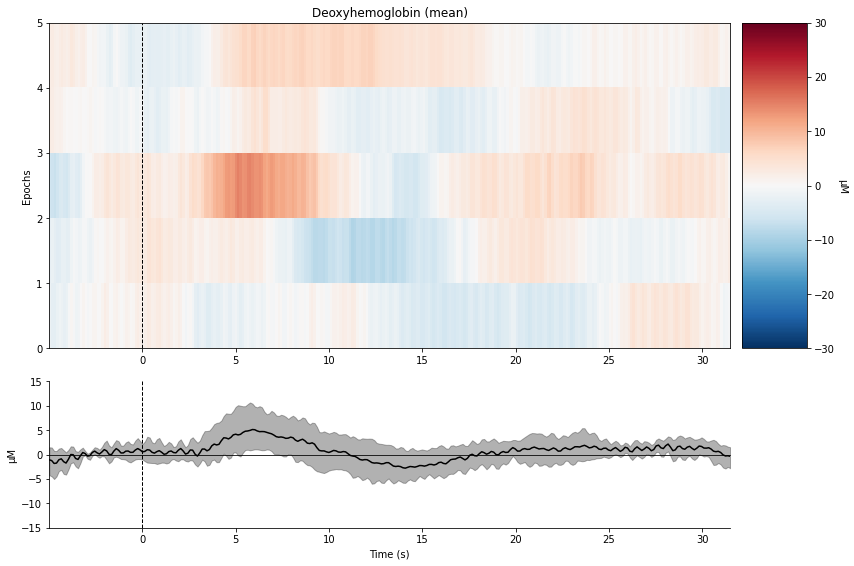

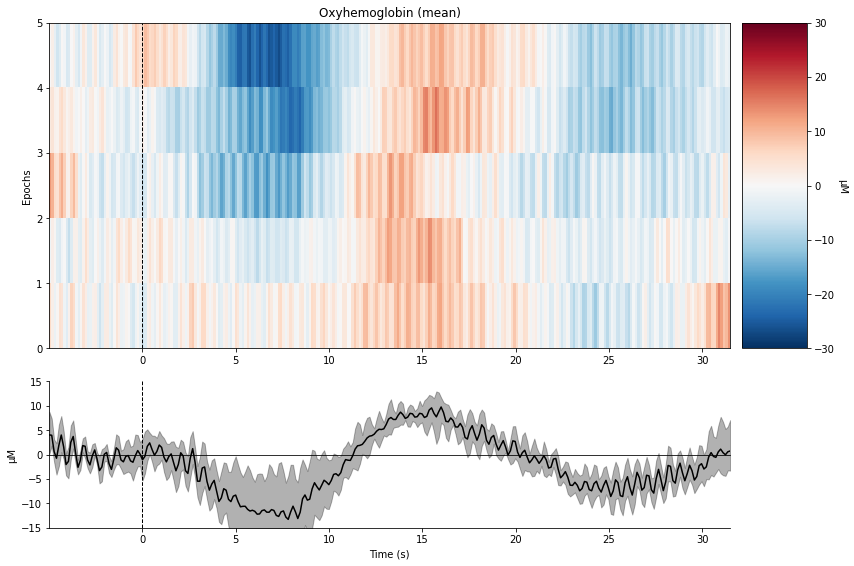

Used Annotations descriptions: ['Directional', 'Indirectional']
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 532 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 286 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


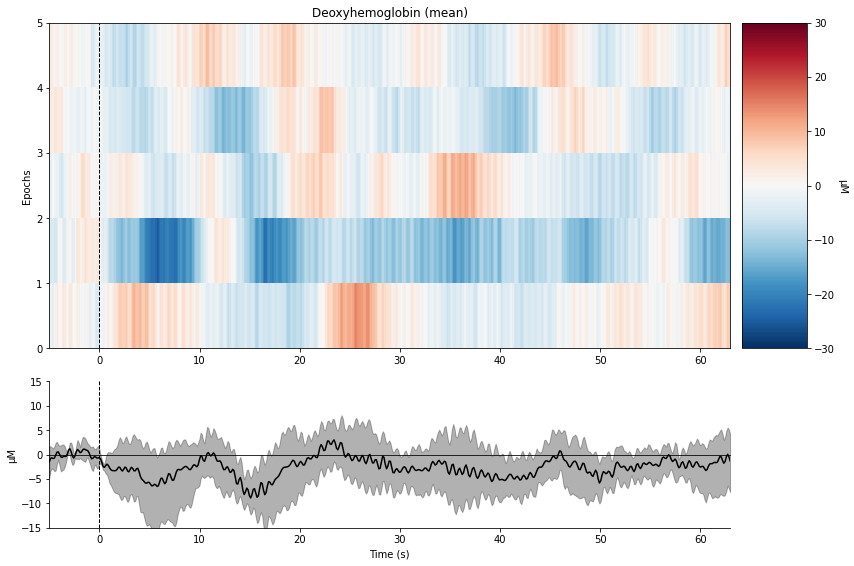

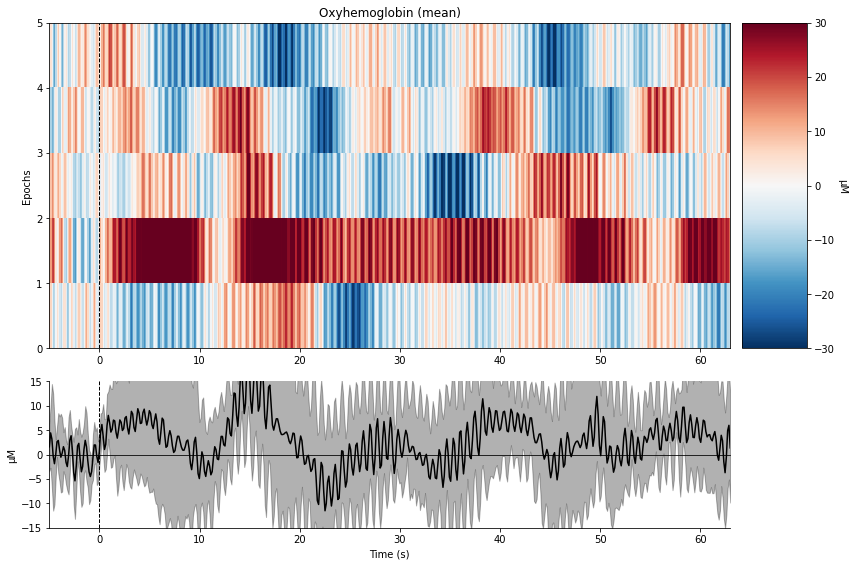

Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


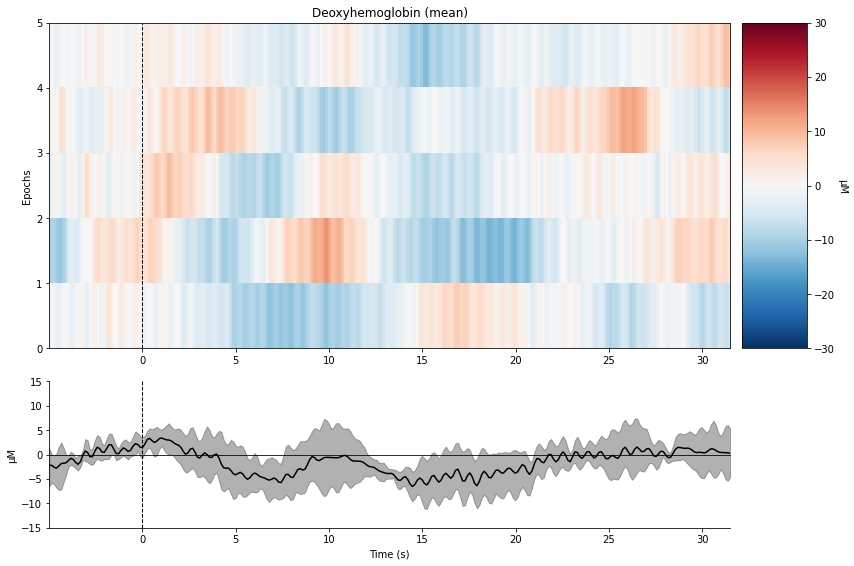

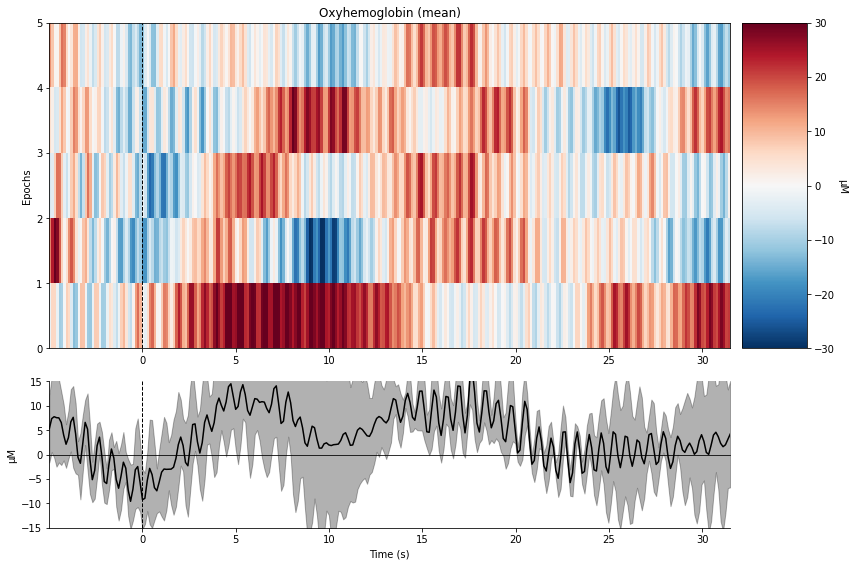

Used Annotations descriptions: ['Directional', 'Indirectional']
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 532 original time points ...
    Rejecting  epoch based on HBO : ['S1_D1 hbo']
1 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 286 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
4 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
4 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


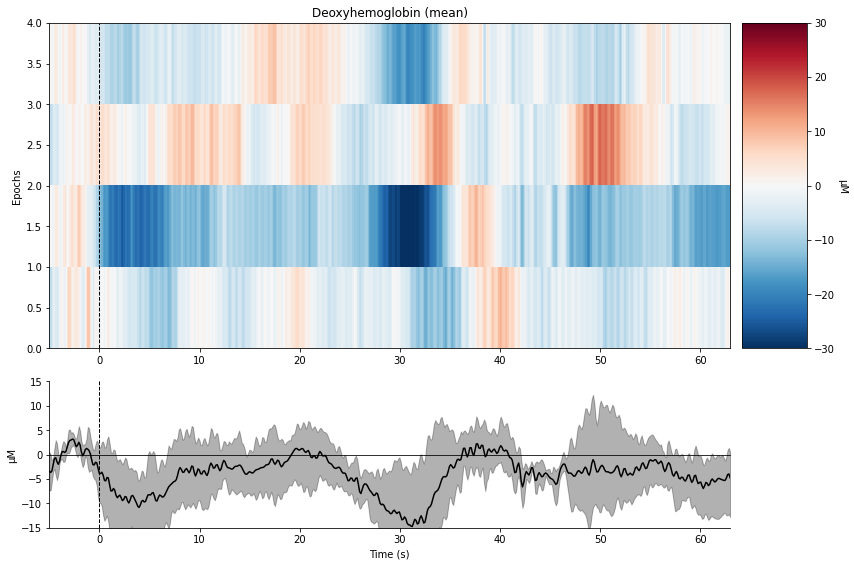

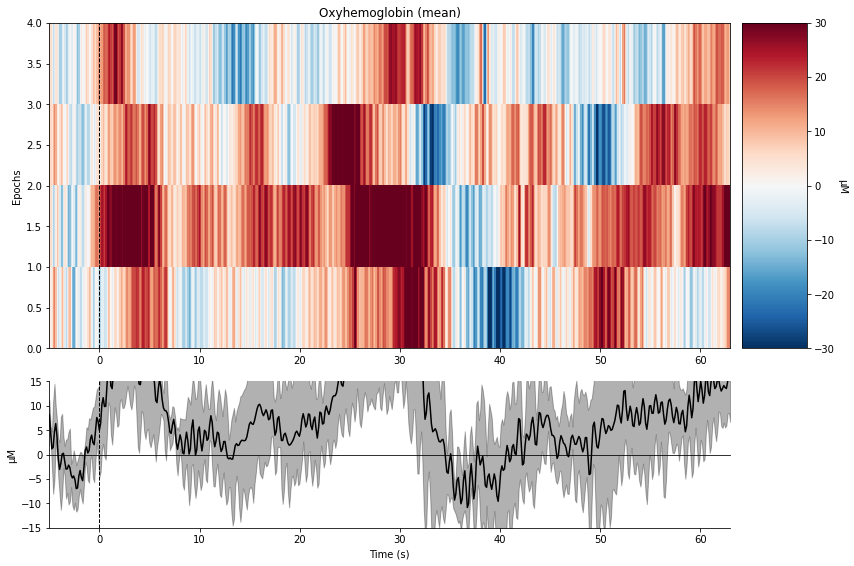

Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


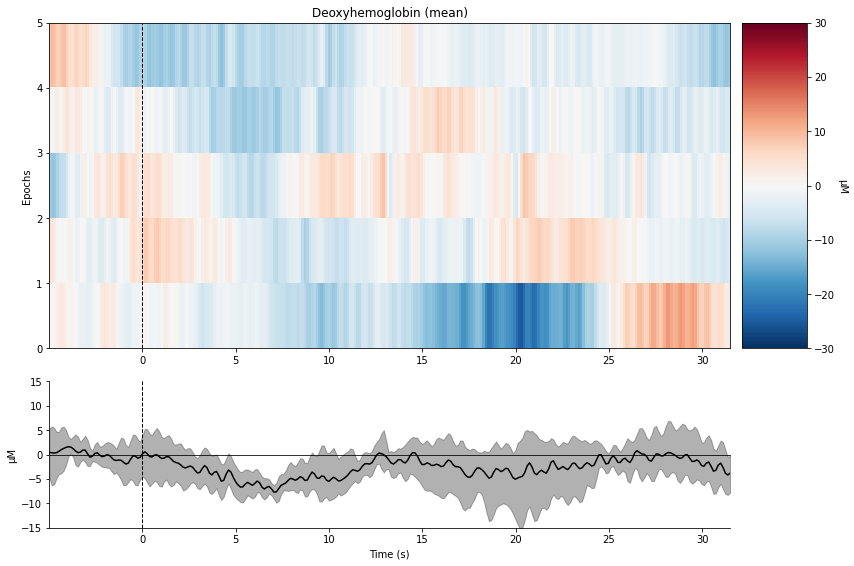

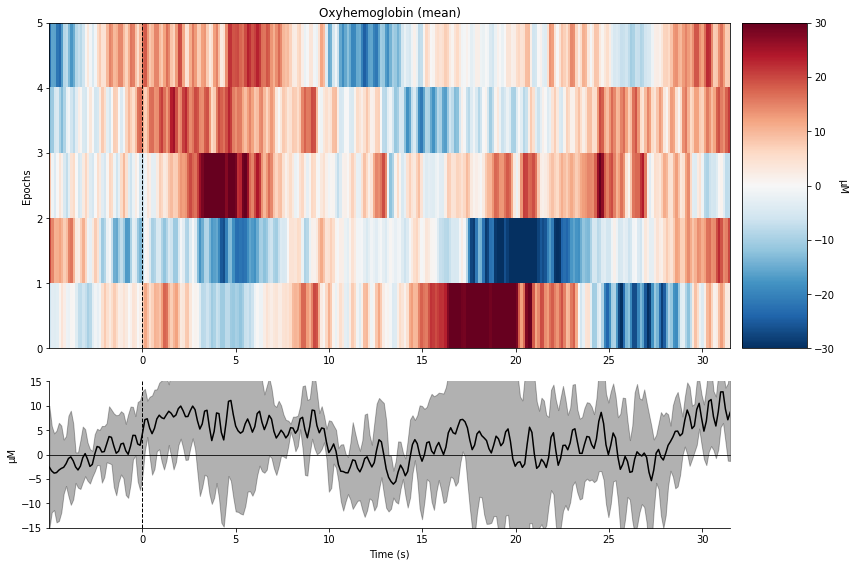

Used Annotations descriptions: ['Directional', 'Indirectional']
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 532 original time points ...
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S8_D4 hbo']
    Rejecting  epoch based on HBO : ['S4_D2 hbo', 'S5_D3 hbo', 'S6_D3 hbo']
4 bad epochs dropped
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 286 original time points ...
    Rejecting  epoch based on HBO : ['S8_D4 hbo']
    Rejecting  epoch based on HBO : ['S5_D3 hbo']
2 bad epochs dropped
Not setting metadata
Not setting metadata
1 matching events found
No baseline corr

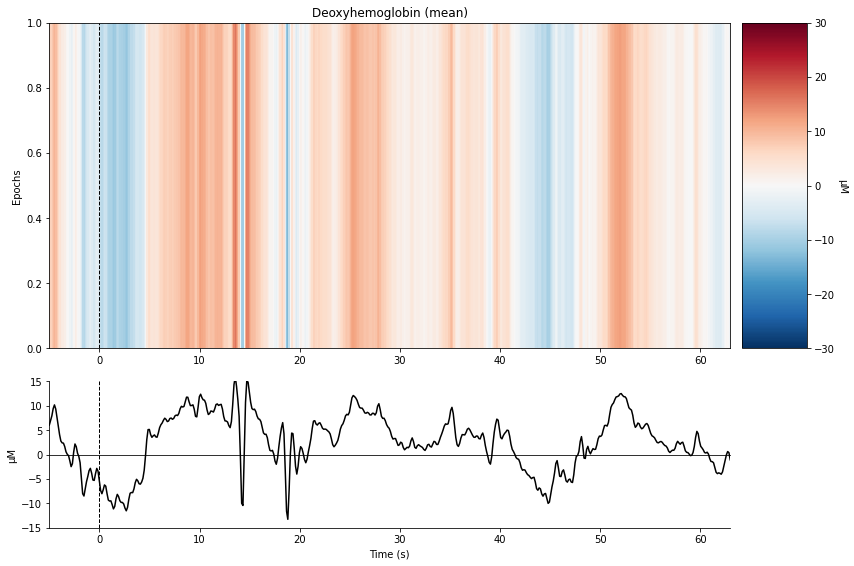

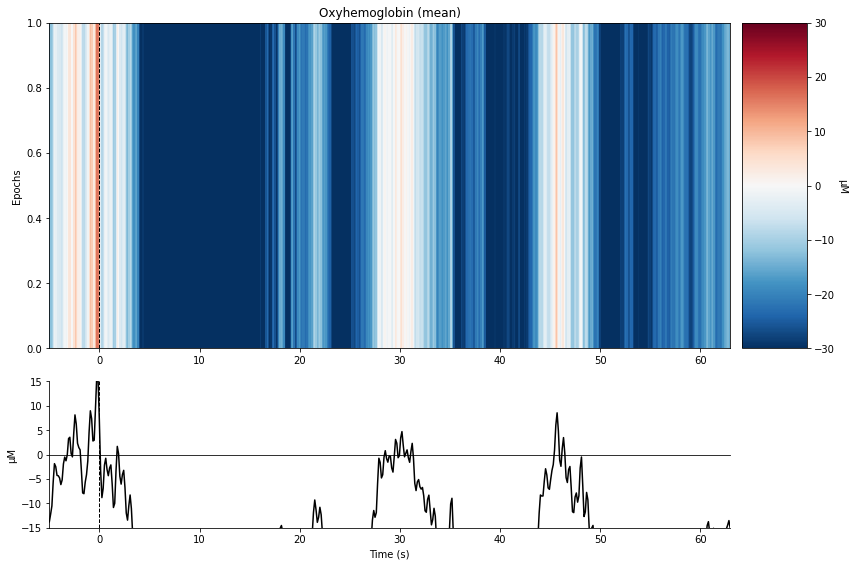

Not setting metadata
Not setting metadata
3 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
3 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "mean"
combining channels using "mean"


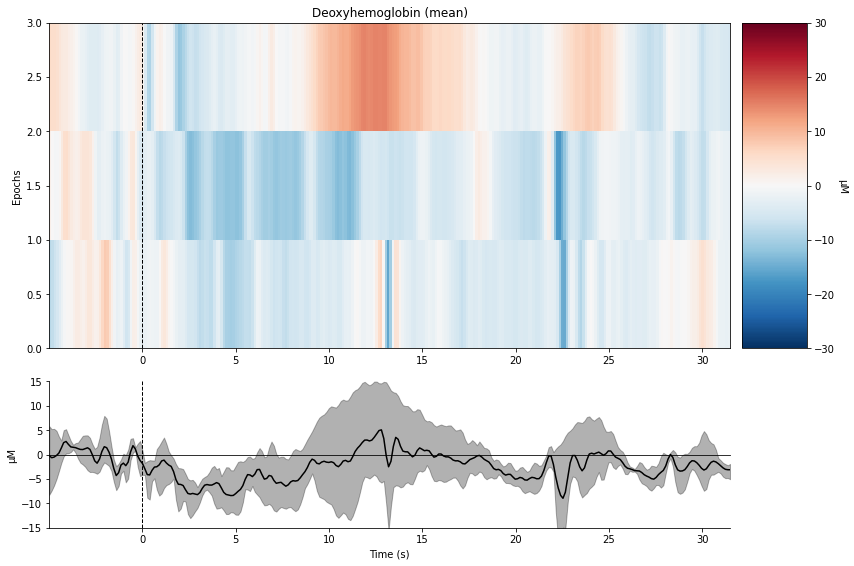

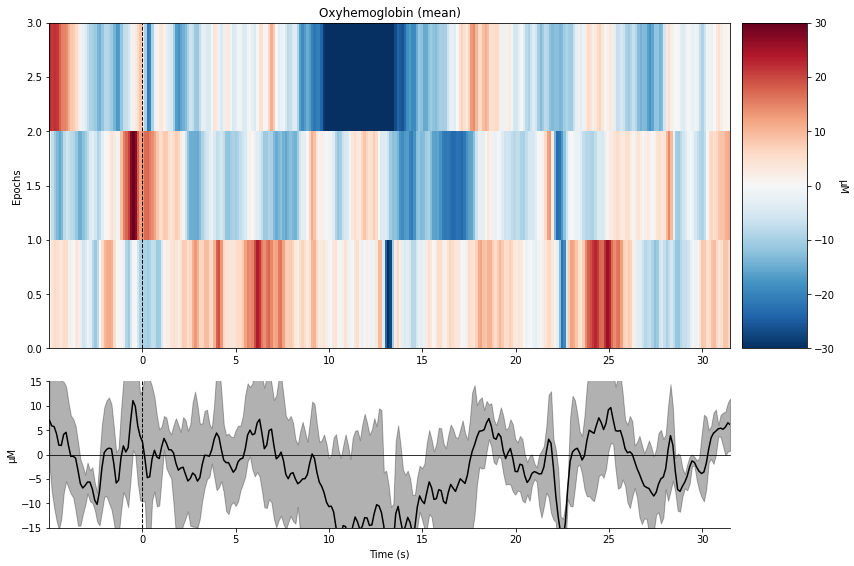

Used Annotations descriptions: ['Directional', 'Indirectional']
Not setting metadata
Not setting metadata
5 matching events found
Setting baseline interval to [-4.992, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 5 events and 532 original time points ...
    Rejecting  epoch based on HBO : ['S2_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo']
    Rejecting  epoch based on HBO : ['S1_D1 hbo', 'S2_D1 hbo', 'S2_D2 hbo', 'S3_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo', 'S6_D3 hbo', 'S7_D3 hbo', 'S7_D4 hbo', 'S8_D4 hbo']
    Rejecting  epoch based on HBO : ['S2_D2 hbo', 'S3_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo', 'S6_D3 hbo', 'S7_D3 hbo', 'S8_D4 hbo']
    Rejecting  epoch based on HBO : ['S1_D1 hbo', 'S2_D1 hbo', 'S2_D2 hbo', 'S3_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo', 'S7_D3 hbo']
    Rejecting  epoch based on HBO : ['S2_D1 hbo', 'S2_D2 hbo', 'S3_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo', 'S6_D3 hbo', 'S7_D3 hbo', 'S7_D4 hbo', 'S8_D4 hbo']
5 bad epochs dropped
Not setting metadat

ValueError: zero-size array to reduction operation maximum which has no identity

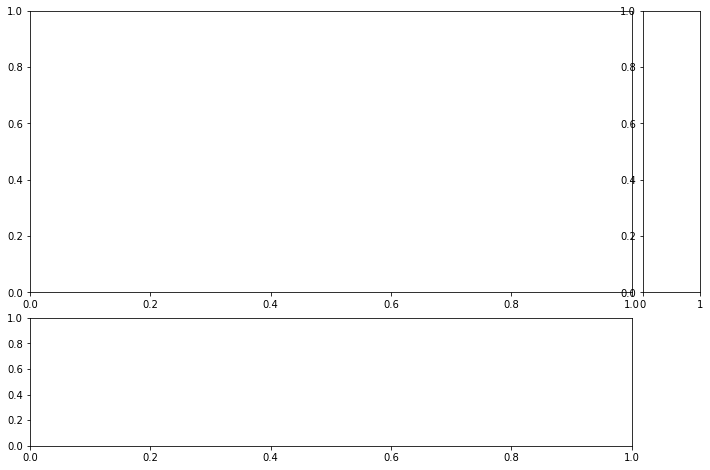

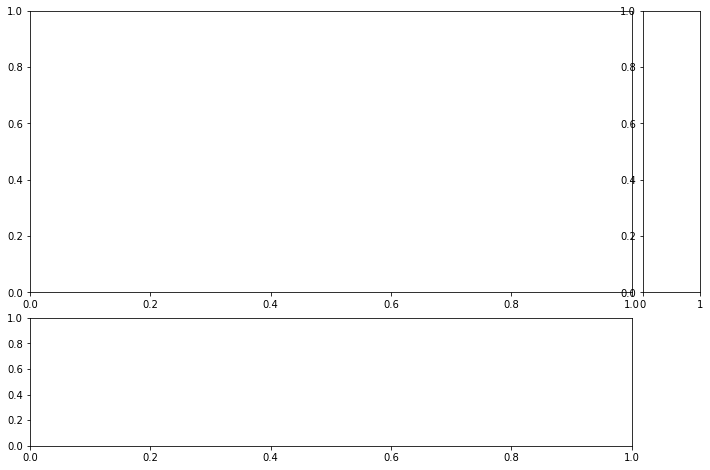

In [49]:
# make a list where all of the epoched data will go 
pp_epochs = []

# loop over all of the preprocessed MNE.io.raw objects
for haemo in pp_haemos:
    
    # get events and event dict
    events, event_dict = mne.events_from_annotations(haemo)

    # peak to trough rejection criteria amplitude
    reject_criteria = dict(hbo=200e-6)
#     reject_criteria = None
    
    # epoch start and end times (tmax is divided by two for indirectional blocks / epochs)
    tmin, tmax = -5, 63
    
    # use mne.Epochs to slice up preprocessed object
    dir_epochs = mne.Epochs(
        haemo, # preprocessed mne object
        events, # events list
        event_id={list(event_dict.keys())[0]: list(event_dict.values())[0]}, # first event key
        tmin=tmin, #tmin
        tmax=tmax, #tmax
        baseline=(None, 0), # the baseline window to use (see mne.Epochs for more info)
        reject=reject_criteria, # peak to trough rejection amplitude
        reject_by_annotation=True,
        detrend=1, # linear detrend
        verbose=True, # print information while loading
        preload=True) # load automatically (memory thing)
    
    # same thing for indirect epochs. only differences are marked
    indir_epochs = mne.Epochs(
        haemo,
        events,
        event_id={list(event_dict.keys())[1]: list(event_dict.values())[1]}, # second event key
        tmin=tmin,
        tmax=tmax/2, # half the duration
        baseline=(None, 0),
        reject=reject_criteria,
        reject_by_annotation=True,
        detrend=1,
        verbose=True,
        preload=True)
    
    # append a tuple of the (directional epochs, indirectional epochs) to the pp_epochs list
    pp_epochs.append((dir_epochs, indir_epochs))
    
# remove bad epochs?
#     epochs.drop_bad()
#     epochs.plot_drop_log()

    # plot the mean-averaged epoch for both types
    dir_epochs.plot_image(
        combine='mean',
        vmin=-30,
        vmax=30,
        ts_args=dict(ylim=dict(
            hbo=[-15, 15],
            hbr=[-15, 15])))
    
    indir_epochs.plot_image(
        combine='mean',
        vmin=-30,
        vmax=30,
        ts_args=dict(ylim=dict(
            hbo=[-15, 15],
            hbr=[-15, 15])))

In [ ]:
# make a results dataframe (csv basically)
results = pd.DataFrame()

# make a dictionary with all of the ROIs' channels
ROIs = {
    'Left Frontal': ['S3_D2 hbo', 'S4_D2 hbo'],
    'Right Frontal': ['S5_D3 hbo', 'S6_D3 hbo'],
    'Left Temporal': ['S1_D1 hbo', 'S2_D1 hbo', 'S2_D2 hbo'],
    'Right Temporal': ['S7_D3 hbo', 'S7_D4 hbo', 'S8_D4 hbo']}

# iterate list of epoch tuples
for epochs in pp_epochs:
    
    # iterate first or second item in tuple
    for i, condition in enumerate(['Directional', 'Indirectional']):
        
        # get subject number
        sub = epochs[i].info['subject_info']['his_id'][:participant_num_len]
        
        # make a dictionary for doing epoch by ROI
        epochROIs = {}
        
        for ROI in ROIs:
            
            # pick out the channels of the ROI from this epoch and add to the epochROIs dict
            try:
                epochROIs[ROI] = epochs[i].copy().pick(ROIs[ROI])
            except:
                epochROIs[ROI] = None
        
        # iterate Epochs object within one item of tuple
        # i.e. looking at 1 epoch / block / condition at a time
        # hbo channels only
        for j, epoch in enumerate(epochs[i].copy().pick('hbo')):
        
            ans = {}
            ans["Subject"] = sub # add subject number
            ans["Age"] = ages[all_subs.index(sub)] # add age
            ans["Condition"] = condition # get condition (dir or indir)
            ans["Mean"] = epoch.mean() * 1e6 # get global mean HbO value
            
            # do ROI-based means as well
            for ROI in ROIs:
                if epochROIs[ROI] is not None:
                    for z, e in enumerate(epochROIs[ROI]):
                        if z == j:
                            ans[ROI+" Mean"] = e.mean() * 1e6
                else:
                    ans[ROI+" Mean"] = None

            # add ans to the dataframe
            results = results.append(
                ans,
                ignore_index=True)

In [ ]:
results

In [ ]:
# filter the data frame for rows who don't have Age as equal to zero (error from not having birthdays entered correctly in data tracker)
results[results['Age']==0]

In [ ]:
# save the results as a CSV
results.to_csv("/data/perlman/moochie/analysis/P-CAT/NIRSstats_new.csv")

In [ ]:
results

In [ ]:
df = results

In [ ]:
import scipy
import dabest

In [ ]:
plt.rcParams['savefig.facecolor']='white'

cols = [col for col in df.columns if \
    ("Mean" in col)]

for coi in cols:

    fig, ax = plt.subplots()

    c=['red' if str(sub) not in PSU_insubs else 'blue' for sub in df[~pd.isnull(df[coi])]['Subject']]
    
    scatter = ax.scatter(
        df[~pd.isnull(df[coi])]['Age'].astype(float),
        df[~pd.isnull(df[coi])][coi].astype(float),
        c=c)

    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[~pd.isnull(df[coi])]['Age'].astype(float), df[~pd.isnull(df[coi])][coi].astype(float))

    xseq = np.linspace(0, max(df['Age'])+0.2, num=100)

    bestfit = ax.plot(xseq, intercept + slope * xseq, color='k', lw=2.5, label='r^2={:.2f}'.format(r_value**2))

    plt.xlabel('Age (years)')
    plt.ylabel(coi)
    plt.xlim((min(df[~pd.isnull(df[coi])]['Age'])-0.2, max(df[~pd.isnull(df[coi])]['Age'])+0.2))
    plt.title('Flanker Age vs. ' + coi + ' (WU Red, PSU Blue)')

    plt.legend(loc="upper right")

    plt.savefig("/data/perlman/moochie/analysis/P-CAT/RTplot_{}_2.png".format(coi))
    
    df[coi] = df[coi].apply(pd.to_numeric, errors='coerce')
    analysis_of_long_df = dabest.load(results[~pd.isnull(results[coi])], idx=("Indirectional", "Directional"), x="Condition", y=coi)
    analysis_of_long_df.mean_diff.plot(swarm_label="Oxyhaemoglobin (µM)\nEpoched {}".format(coi))

In [ ]:
for epochs in pp_epochs:
    
    clims = dict(hbo=[-20, 20], hbr=[-20, 20])
    
    for column, condition in enumerate(['Directional', 'Indirectional']):
        epochs[column].average().plot_image(clim=clims)

In [52]:
for epochs in pp_epochs:
    
    evoked_dict = {
        'Directional/HbO': epochs['Directional'].average(picks='hbo'),
        'Directional/HbR': epochs['Directional'].average(picks='hbr'),
        'Indirectional/HbO': epochs['Indirectional'].average(picks='hbo'),
        'Indirectional/HbR': epochs['Indirectional'].average(picks='hbr')}

    # Rename channels until the encoding of frequency in ch_name is fixed
    for condition in evoked_dict:
        evoked_dict[condition].rename_channels(lambda x: x[:-4])

    color_dict = dict(HbO='#AA3377', HbR='b')
    styles_dict = dict(Indirectional=dict(linestyle='dashed'))

    mne.viz.plot_compare_evokeds(evoked_dict, combine="mean", ci=0.95,
                                 colors=color_dict, styles=styles_dict)
    
    times = np.arange(-3.5, 31.5, 3.0)
    topomap_args = dict(extrapolate='local')
    epochs['Directional'].average(picks='hbo').plot_joint(
        times=times, topomap_args=topomap_args)

TypeError: tuple indices must be integers or slices, not str